<a href="https://colab.research.google.com/github/jouwenlu/NeRF-model/blob/main/NeRF_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## CIS 580, Machine Perception, Spring 2023


Instructions:  Refrain from using a GPU during implementing and testing the whole thing. You should switch to a GPU runtime only when performing the final training (of the 2D image or the NeRF) to avoid GPU usage runouts.

### Part 1: Fitting a 2D Image

In [ ]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time
import gdown
import math

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


First download the image from the web. Normalize the image so the pixels are in between the range of [0,1].

In [ ]:
url = "https://drive.google.com/file/d/1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT/view?usp=share_link"
gdown.download(url=url, output='starry_night.jpg', quiet=False, fuzzy=True)

# Load painting image
painting = imageio.imread("starry_night.jpg")
painting = torch.from_numpy(np.array(painting, dtype=np.float32)/255.).to(device)
height_painting, width_painting = painting.shape[:2]

Downloading...
From: https://drive.google.com/uc?id=1-Cugk9WiFX2CPjWG5taX3868Gdd0PEVT
To: /content/starry_night.jpg
100%|██████████| 5.65k/5.65k [00:00<00:00, 4.05MB/s]


1.1 Function positional_encoding()

In [ ]:
def positional_encoding(x, num_frequencies=6, incl_input=True):

    """
    Apply positional encoding to the input.

    Args:
    x (torch.Tensor): Input tensor to be positionally encoded.
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor.
    """

    results = []
    if incl_input:
        results.append(x)
    # L = num_frequencies, N = batch size, D = dim of each input
    # x = (N, D) -> (N,2LD)
    #x, y, sin(2pix), sin(2piy), cos(2pix), cos(2piy), sin(4pix)...

    # create A = 2 pix, 2piy, 4pix 4piy vectors first (2D array)! (N, D, L)
    N, D = x.shape
    L = num_frequencies

    freq_idx = 2**torch.arange(L).to(device)*np.pi # (L)
    freq_idx = freq_idx.unsqueeze(0).repeat(N, 1) # (N, L)
    freq_idx = freq_idx.unsqueeze(2).repeat(1, 1, D) # (N, L, D)
    x_exp = x.unsqueeze(1).repeat(1, L, 1) # (N, L, D)
    x_freq = freq_idx * x_exp # (N, L, D)
    # add sin(A) and cos(A), stack them on top,  ((N, L, 2D) stack, then reshape
    sin_x, cos_x = torch.sin(x_freq), torch.cos(x_freq)
    enc_x = torch.cat((sin_x, cos_x), dim=2) # (N, L, 2D)
    enc_x = enc_x.reshape((N, 2*D*L))
    results.append(enc_x)


    return torch.cat(results, dim=-1)

1.2 class model_2d() that will be used to fit the 2D image.


In [ ]:
class model_2d(nn.Module):

    """
    Define a 2D model comprising of three fully connected layers,
    two relu activations and one sigmoid activation.
    """
    def __init__(self, filter_size=128, num_frequencies=6):
        super().__init__()

        input_dim = 2 * num_frequencies * 2 + 2
        self.model = nn.Sequential(
            nn.Linear(input_dim, filter_size),
            nn.ReLU(),
            nn.Linear(filter_size, filter_size),
            nn.ReLU(),
            nn.Linear(filter_size, 3),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.model(x)
        return x

train_2d_model() function trains the model to fit the 2D image.

In [ ]:
def train_2d_model(test_img, num_frequencies, device, model=model_2d, positional_encoding=positional_encoding, show=True):

    # Optimizer parameters
    lr = 5e-4
    iterations = 10000
    height, width = test_img.shape[:2]

    # Number of iters after which stats are displayed
    display = 2000

    # Define the model and initialize its weights.
    model2d = model(num_frequencies=num_frequencies)
    model2d.to(device)

    def weights_init(m):
        if isinstance(m, nn.Linear):
            torch.nn.init.xavier_uniform_(m.weight)

    model2d.apply(weights_init)

    # Define the optimizer
    optimizer = torch.optim.Adam(model2d.parameters(), lr=lr)
    loss_func = nn.MSELoss()
    loss_func = loss_func.to(device)

    # Seed RNG, for repeatability
    seed = 5670
    torch.manual_seed(seed)
    np.random.seed(seed)

    # Lists to log metrics etc.
    psnrs = []
    iternums = []

    t = time.time()
    t0 = time.time()

    # Create the 2D normalized coordinates, and apply positional encoding to them
    x = torch.empty((0, 2))
    for h in range(height):
      for w in range(width):
          x = torch.cat((x, torch.tensor([[h/height, w/width]])), dim=0)
    x = positional_encoding(x, num_frequencies)

    for i in range(iterations+1):
        optimizer.zero_grad()
        # Run one iteration
        pred = model2d(x).reshape(height, width, 3) # transform back to image
        # Compute mean-squared error between the predicted and target images. Backprop!
        loss = loss_func(pred, test_img)
        loss.backward()
        optimizer.step()


        # Display images/plots/stats
        if i % display == 0 and show:
            # Calculate psnr
            R = 1
            psnr = torch.tensor([10 * math.log10(R**2 / loss)])

            print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f" % psnr.item(), \
                "Time: %.2f secs per iter" % ((time.time() - t) / display), "%.2f secs in total" % (time.time() - t0))
            t = time.time()

            psnrs.append(psnr.item())
            iternums.append(i)

            plt.figure(figsize=(13, 4))
            plt.subplot(131)
            plt.imshow(pred.detach().cpu().numpy())
            plt.title(f"Iteration {i}")
            plt.subplot(132)
            plt.imshow(test_img.cpu().numpy())
            plt.title("Target image")
            plt.subplot(133)
            plt.plot(iternums, psnrs)
            plt.title("PSNR")
            plt.show()

    print('Done!')
    return pred.detach().cpu()

Train the model to fit the given image without applying positional encoding to the input, and by applying positional encoding of two different frequencies to the input; L = 2 and L = 6.

Iteration 0  Loss: 0.0699  PSNR: 11.56 Time: 0.00 secs per iter 0.73 secs in total


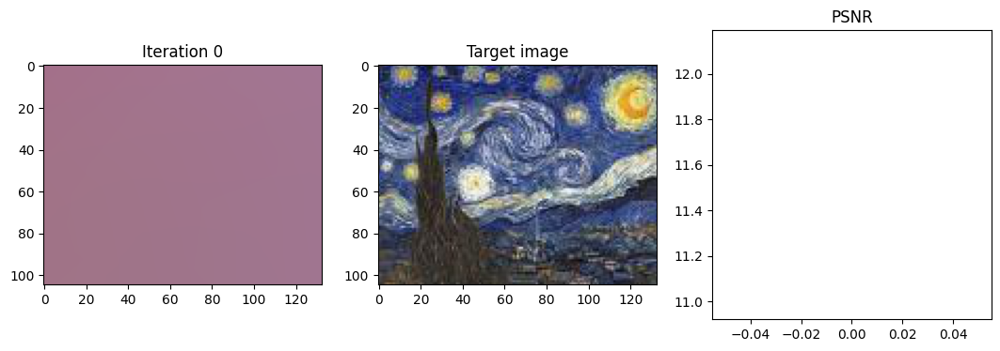

Iteration 2000  Loss: 0.0204  PSNR: 16.89 Time: 0.05 secs per iter 94.50 secs in total


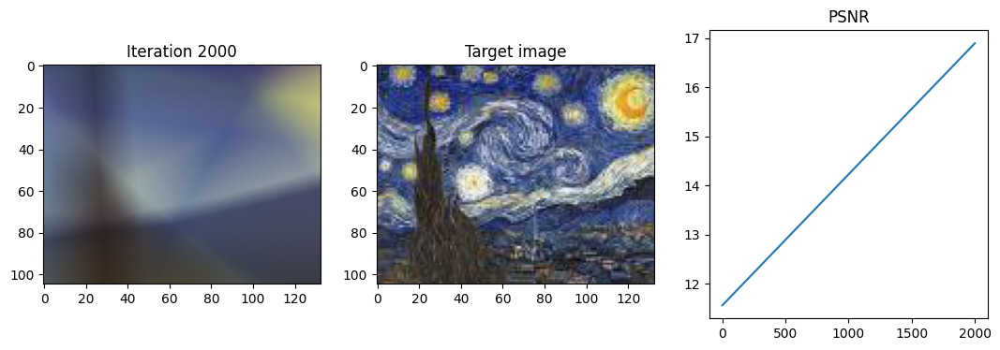

Iteration 4000  Loss: 0.0163  PSNR: 17.88 Time: 0.05 secs per iter 189.67 secs in total


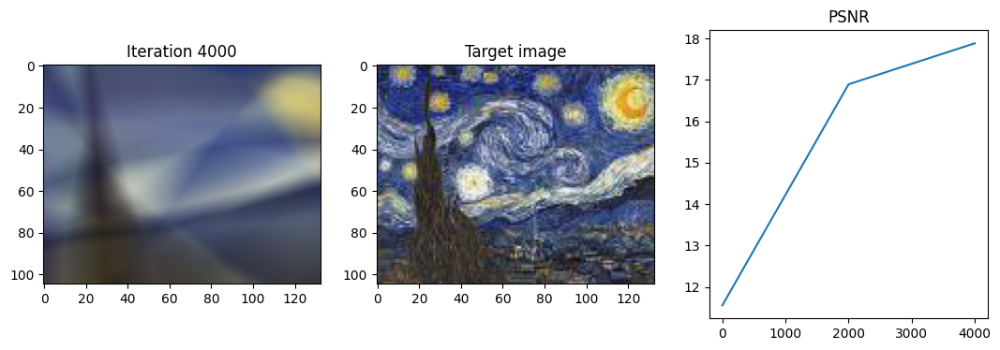

Iteration 6000  Loss: 0.0150  PSNR: 18.23 Time: 0.05 secs per iter 284.74 secs in total


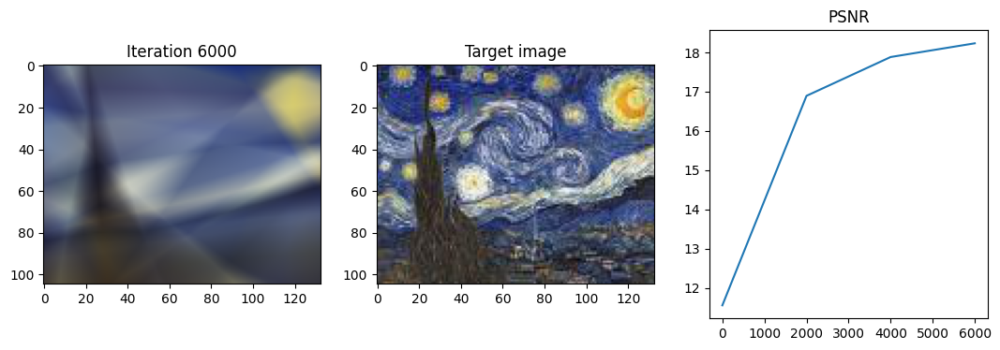

KeyboardInterrupt: ignored

In [ ]:
_ = train_2d_model(test_img=painting, num_frequencies=0, device=device)

### Part 2: Fitting a 3D Image

In [ ]:
import os
import gdown
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time
from tqdm.notebook import tqdm, trange

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
url = "https://drive.google.com/file/d/15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj/view?usp=share_link"
gdown.download(url=url, output='lego_data.npz', quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=15W2EK8LooxTMfD0v5vo2BnBMse5ZzlVj
To: /content/lego_data.npz
100%|██████████| 12.7M/12.7M [00:00<00:00, 78.7MB/s]


'lego_data.npz'

Here, we load the data that is comprised by the images, the R and T matrices of each camera position with respect to the world coordinates and the intrinsics parameters K of the camera.

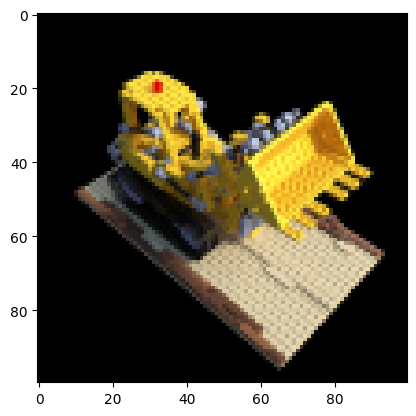

In [ ]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

2.1 %he following function calculates the rays that pass through all the pixels of an HxW image

In [ ]:
def get_rays(height, width, intrinsics, Rwc, Twc): # Rwc, Twc

    """
    Compute the origin and direction of rays passing through all pixels of an image (one ray per pixel).

    Args:
    height: the height of an image.
    width: the width of an image.
    intrinsics: camera intrinsics matrix of shape (3, 3).
    Rcw: Rotation matrix of shape (3,3) from camera to world coordinates.
    Tcw: Translation vector of shape (3,1) that transforms

    Returns:
    ray_origins (torch.Tensor): A tensor of shape (height, width, 3) denoting the centers of
      each ray. Note that desipte that all ray share the same origin, here we ask you to return
      the ray origin for each ray as (height, width, 3).
    ray_directions (torch.Tensor): A tensor of shape (height, width, 3) denoting the
      direction of each ray.
    """

    device = intrinsics.device

    ray_origins = torch.zeros((height, width, 3), device=device)  # placeholder
    ray_origins[:, :, :] = Twc

    H = (Rwc @ torch.inverse(intrinsics).to(device))
    v, u = torch.meshgrid(torch.arange(height).to(device), torch.arange(width).to(device), indexing="ij")
    pixels = torch.zeros((3, height * width), device=device)
    pixels[0, :] = u.flatten()
    pixels[1, :] = v.flatten()
    pixels[2, :] = torch.ones(height * width).to(device)
    ray_directions = (H @ pixels).T
    ray_directions = ray_directions.reshape((height, width, 3))

    return ray_origins, ray_directions

2.2 Implement the sampling of points along a given ray.

In [ ]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):

    """
    Sample 3D points on the given rays. The near and far variables indicate the bounds of sampling range.

    Args:
    ray_origins: Origin of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    ray_directions: Direction of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    near: The 'near' extent of the bounding volume.
    far:  The 'far' extent of the bounding volume.
    samples: Number of samples to be drawn along each ray.

    Returns:
    ray_points: Query 3D points along each ray. Shape: (height, width, samples, 3). # for each pixel, list of sample pts along each ray
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
    """

    height = ray_origins.size(dim=0)
    width = ray_origins.size(dim=1)

    # Vectorize operations
    depth_pts_pixel = near + torch.arange(samples).to(device)*(far - near)/samples # size: (samples)
    depth_points = depth_pts_pixel.unsqueeze(0).repeat(width, 1)
    depth_points = depth_points.unsqueeze(0).repeat(height, 1, 1)

    ray_org_expanded = ray_origins.unsqueeze(2).repeat(1, 1, samples, 1)
    ray_dir_expanded = ray_directions.unsqueeze(2).repeat(1, 1, samples, 1)
    depth_pts_expanded = depth_points.unsqueeze(3).repeat(1, 1, 1, 3)
    ray_points = ray_org_expanded + depth_pts_expanded * ray_dir_expanded # (height, width, samples, 3)

    return ray_points, depth_points

2.3 Define the network architecture of NeRF along with a function that divided data into chunks to avoid memory leaks during training.

In [ ]:
class nerf_model(nn.Module):

    """
    Define a NeRF model comprising eight fully connected layers and following the
    architecture described in the NeRF paper.
    """

    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()

        input_pos = 2 * 3 * num_x_frequencies + 3  # 3 (x,y,z)* positional encoding = 2LD
        input_dir = 2 * 3 * num_d_frequencies + 3

        self.input_layer = nn.Linear(input_pos, filter_size)
        self.layer_2 = nn.Linear(filter_size, filter_size)
        self.layer_3 = nn.Linear(filter_size, filter_size)
        self.layer_4 = nn.Linear(filter_size, filter_size)
        # self.layer_5 = nn.Linear(filter_size, filter_size + input_pos)
        self.layer_5 = nn.Linear(filter_size, filter_size)
        self.layer_6 = nn.Linear(filter_size + input_pos, filter_size)
        self.layer_7 = nn.Linear(filter_size, filter_size)
        self.layer_8 = nn.Linear(filter_size, filter_size)
        # Sigma branch
        self.sigma_output_layer = nn.Linear(filter_size, 1)
        # RBG branch
        self.layer_9 = nn.Linear(filter_size, filter_size)
        self.layer_10 = nn.Linear(filter_size + input_dir, 128)
        self.rgb_output_layer = nn.Linear(128, 3)


    def forward(self, x, d):
        h_1 = F.relu(self.input_layer(x))
        h_2 = F.relu(self.layer_2(h_1))
        h_3 = F.relu(self.layer_3(h_2))
        h_4 = F.relu(self.layer_4(h_3))
        h_5 = F.relu(self.layer_5(h_4))  # input_pos is added to output of layer 5
        h_6 = F.relu(self.layer_6(torch.cat((h_5, x), dim=1)))
        h_7 = F.relu(self.layer_7(h_6))
        h_8 = F.relu(self.layer_8(h_7))
        # sigma branch
        sigma = self.sigma_output_layer(h_8)
        # rgb branch
        h_9 = self.layer_9(h_8)  # input_dir is added to output
        h_10 = F.relu(self.layer_10(torch.cat((h_9, d), dim=1)))
        rgb = torch.sigmoid(self.rgb_output_layer(h_10))

        return rgb, sigma

In [ ]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):

    def get_chunks(inputs, chunksize = 2**15):
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

    """
    This function returns chunks of the ray points and directions to avoid memory errors with the
    neural network. It also applies positional encoding to the input points and directions before
    dividing them into chunks, as well as normalizing and populating the directions.

    ray_points: (height, width, samples, 3)
    ray_directions:(height, width, 3).
    """

    height, width = ray_points.size(dim=0), ray_points.size(dim=1)
    samples = ray_points.size(dim=2)

    ray_dir = F.normalize(ray_directions, dim=2)
    ray_dir = ray_dir.unsqueeze(2).repeat(1, 1, samples, 1)  # B = A.unsqueeze(1).repeat(1, K, 1)
    ray_dir = ray_dir.reshape((height * width * samples, 3))  # flatten to (h*w*sample, 3)
    ray_pts = ray_points.reshape((height * width * samples, 3))

    # apply positional encoding to points & directions
    ray_pts_enc = positional_encoding(ray_pts, num_x_frequencies, incl_input=True) # 3-> 2LD = 2 * freq * 3
    ray_dir_enc = positional_encoding(ray_dir, num_d_frequencies, incl_input=True)

    # then split big batch into chunks, then feed chunk one by one to network
    ray_points_batches = get_chunks(ray_pts_enc)
    ray_directions_batches = get_chunks(ray_dir_enc)

    return ray_points_batches, ray_directions_batches

2.4 Compute the compositing weights of samples on camera ray and then complete the volumetric rendering procedure to reconstruct a whole RGB image from the sampled points and the outputs of the neural network.

In [ ]:
def volumetric_rendering(rgb, s, depth_points):

    """
    Differentiably renders a radiance field, given the origin of each ray in the
    "bundle", and the sampled depth values along them.

    Args:
    rgb: RGB color at each query location (X, Y, Z). Shape: (height, width, samples, 3).
    sigma: Volume density at each query location (X, Y, Z). Shape: (height, width, samples).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples). # o + td, match depth with sigma using array index

    Returns:
    rec_image: The reconstructed image after applying the volumetric rendering to every pixel.
    Shape: (height, width, 3) # rbg value at each pixel, viewed from camera
    """

    # for each pixel, calc its Color by aggregating all samples in a ray
    height, width, samples, _ = rgb.shape[:]
    s = F.relu(s) # pass s through ReLU to avoid infinite vals
    Nth_depth_val = torch.full((height, width, 1), 10**9).to(device)
    # find depth_t+1, slice depth_point from t+1 to N-1, then concat the Nth value
    next_depth = torch.cat((depth_points[:, :, 1:], Nth_depth_val), dim=2) #height x width, samples
    delta = next_depth - depth_points # height x width x samples

    # construct vector to call cumprod on: e^-sig1delt1, e^-sig2delt2, etc.
    # after constructing cumprod, each index i should correspond to each sample i
    # transmittance at sample i, is composed of all previous terms from 1 to i-1 (but, not i). Thus, first sample has transmittance 1 for all pix.
    T = torch.cumprod(torch.exp(-s * delta), dim=2) # height x width x samples
    T = torch.roll(T, 1, dims=2)
    T[:, :, 0] = torch.full((height, width), 1).to(device)
     # because there's 100% prob of not hitting other particles bewteen t_near and t, when t = t_near

    # do calcs of constant with (h, w, N, 1), array, then multiple by (h, w, N, 3) which holds color, then flatten by summing over N
    constant_multiple = T * (1 - torch.exp(-s * delta)) # (h, w, samples)
    constant_multiple = constant_multiple.unsqueeze(3).repeat(1, 1, 1, 3) # (h, w, samples, 3)
    rec_image = torch.sum(constant_multiple * rgb, dim=2) # (h, w, 3)

    #############################  TODO 2.4 END  ############################

    return rec_image

2.5 Given the pose position of a camera, compute the camera rays and sample the 3D points along these rays. Divide those points into batches and feed them to the neural network. Concatenate them and use them for the volumetric rendering to reconstructed the final image.

In [ ]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):

    #compute all the rays from the image
    Rwc = pose[:3, :3]
    Twc = pose[:3, 3]
    ray_origins, ray_directions = get_rays(height, width, intrinsics, Rwc, Twc)

    #sample the points from the rays
    ray_points, depth_points = stratified_sampling(ray_origins, ray_directions, near, far, samples)

    #divide data into batches to avoid memory errors
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies)

    #forward pass the batches and concatenate the outputs at the end
    rgb_batches = torch.zeros((0, 3), device=device)
    sigma_batches = torch.zeros(0).to(device)
    for i in range(len(ray_points_batches)): # num of batches
      rgb_batch, sigma_batch = model(ray_points_batches[i], ray_directions_batches[i])
      rgb_batches = torch.cat((rgb_batches, rgb_batch))
      sigma_batches = torch.cat((sigma_batches, sigma_batch))

    rgb = rgb_batches.reshape(height, width, samples, 3) # reshape from (N, 3) -> (height, width, samples, 3)
    sigma = sigma_batches.reshape(height, width, samples) # -> (height, width, samples)

    # Apply volumetric rendering to obtain the reconstructed image
    rec_image = volumetric_rendering(rgb, sigma, depth_points)


    return rec_image

Construct the NeRF Model

In [ ]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
criterion = nn.MSELoss()
criterion = criterion.to(device)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

Iteration 0  Loss: 0.1612  PSNR: 7.93  Time: 1.33 secs per iter,  0.55 mins in total


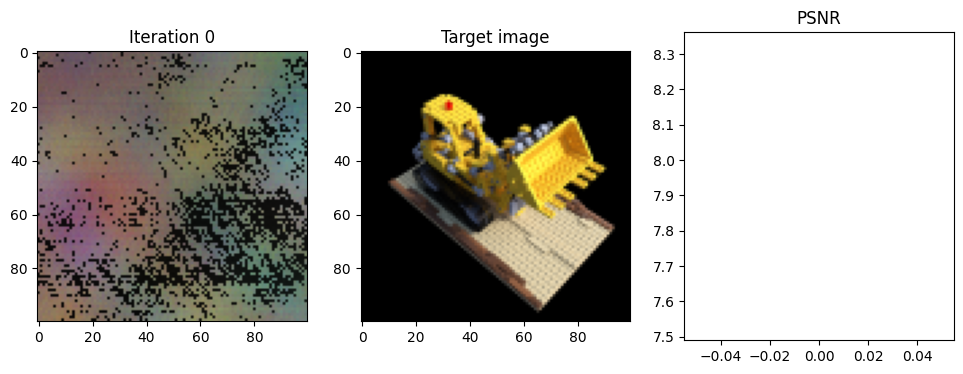

Iteration 25  Loss: 0.0836  PSNR: 10.78  Time: 0.98 secs per iter,  0.96 mins in total


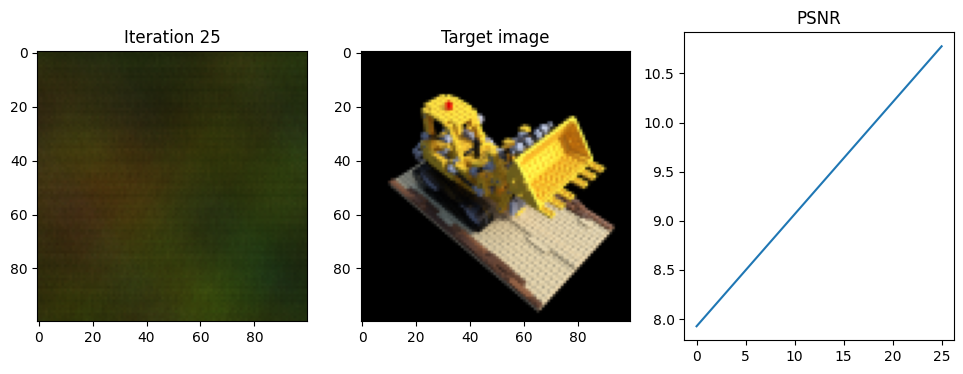

Iteration 50  Loss: 0.0810  PSNR: 10.92  Time: 1.00 secs per iter,  1.38 mins in total


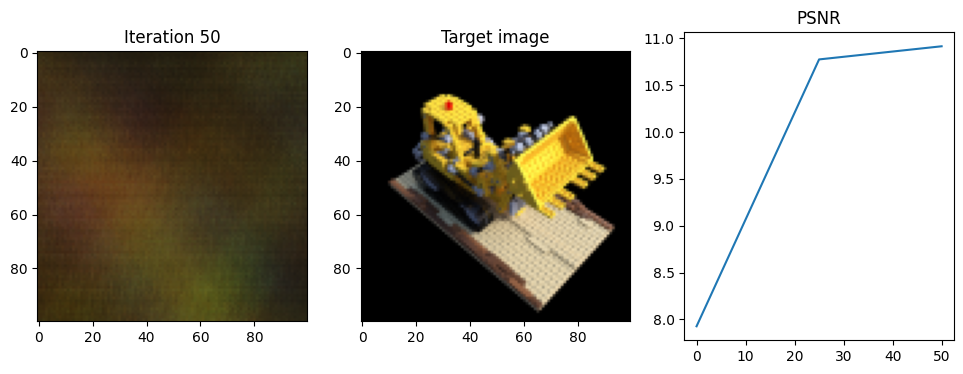

Iteration 75  Loss: 0.0690  PSNR: 11.61  Time: 1.02 secs per iter,  1.80 mins in total


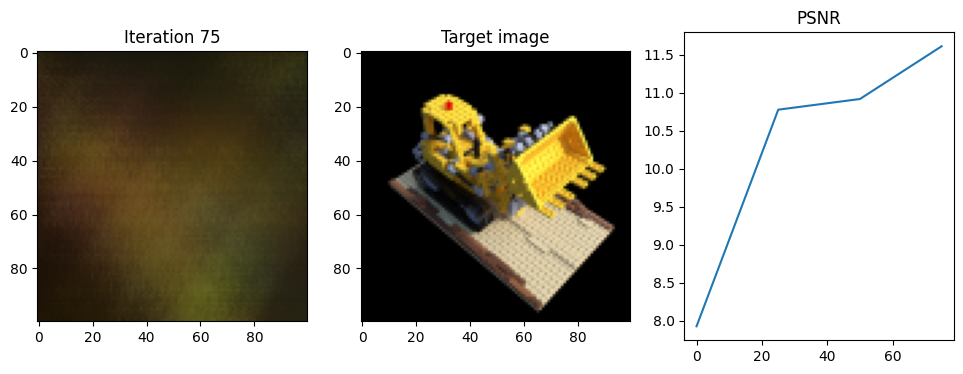

Iteration 100  Loss: 0.0344  PSNR: 14.63  Time: 1.02 secs per iter,  2.22 mins in total


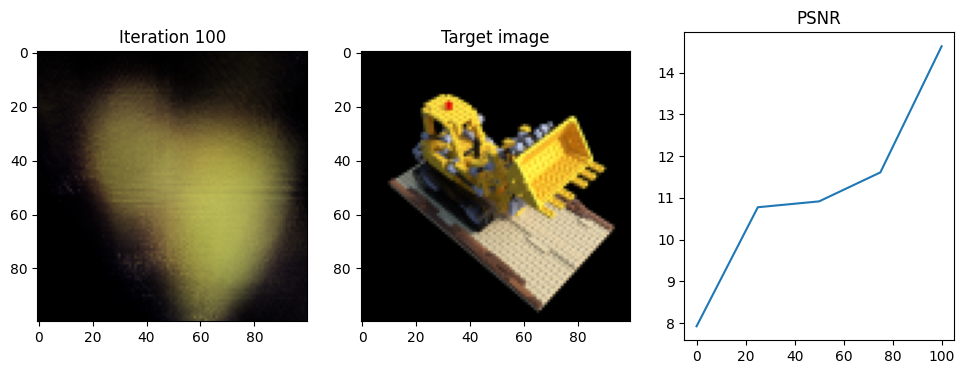

Iteration 125  Loss: 0.0287  PSNR: 15.42  Time: 1.03 secs per iter,  2.65 mins in total


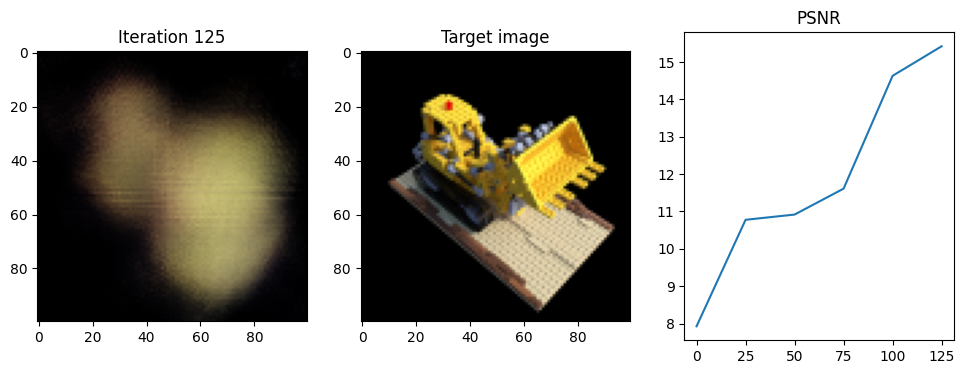

Iteration 150  Loss: 0.0267  PSNR: 15.73  Time: 1.05 secs per iter,  3.09 mins in total


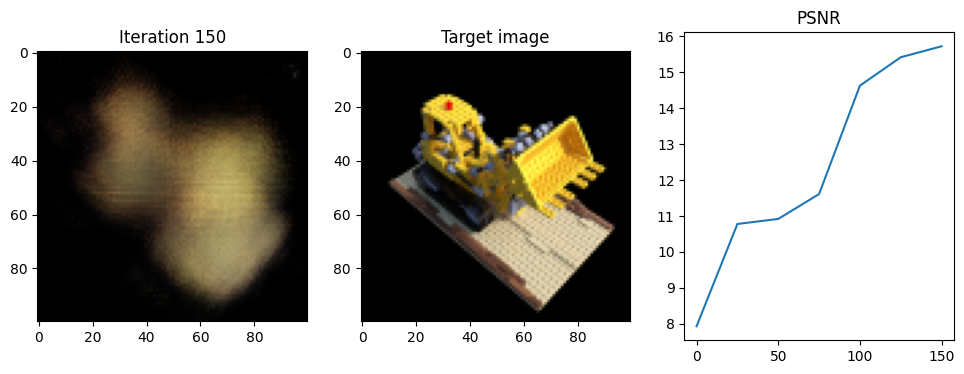

Iteration 175  Loss: 0.0287  PSNR: 15.42  Time: 1.06 secs per iter,  3.53 mins in total


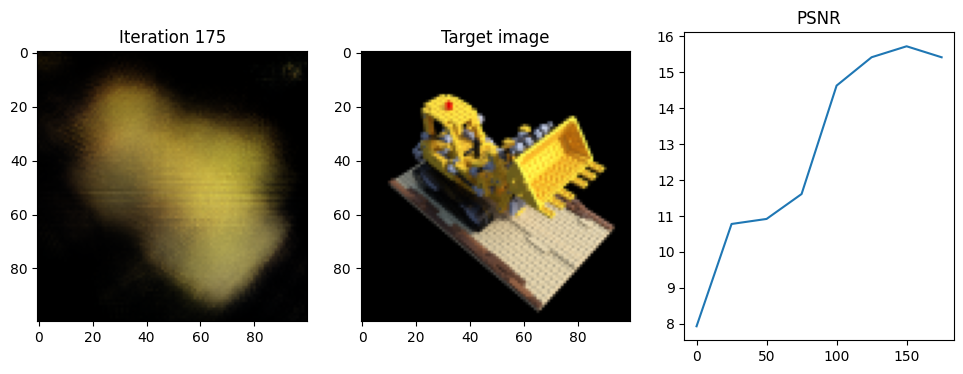

Iteration 200  Loss: 0.0258  PSNR: 15.89  Time: 1.03 secs per iter,  3.96 mins in total


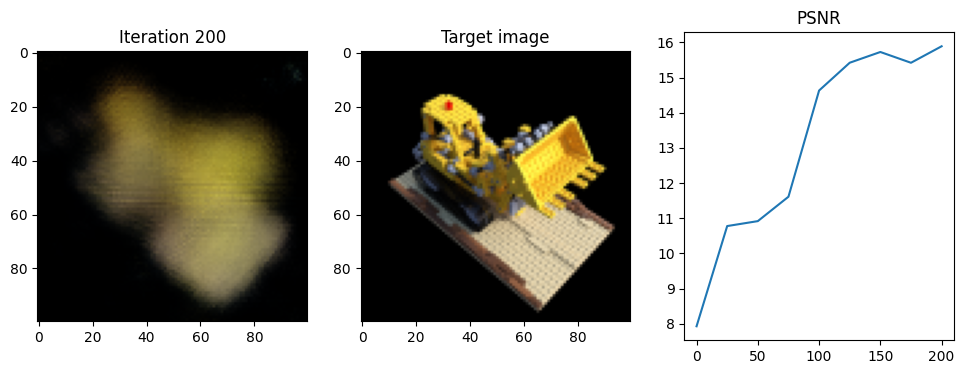

Iteration 225  Loss: 0.0179  PSNR: 17.48  Time: 1.03 secs per iter,  4.38 mins in total


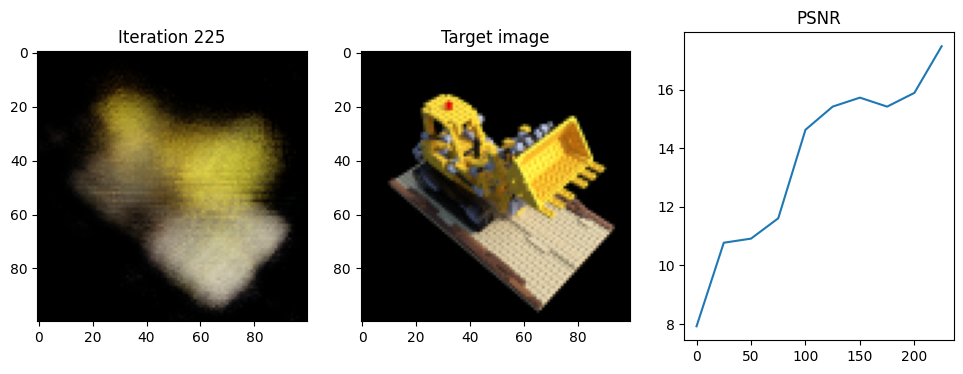

Iteration 250  Loss: 0.0175  PSNR: 17.56  Time: 1.03 secs per iter,  4.81 mins in total


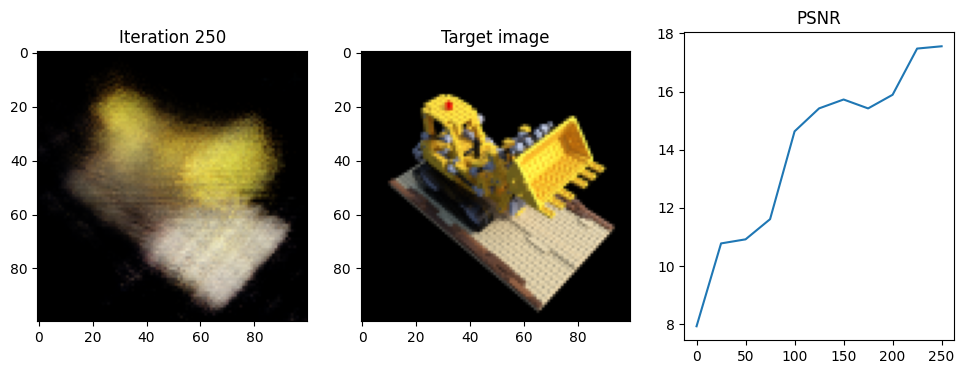

Iteration 275  Loss: 0.0155  PSNR: 18.10  Time: 1.02 secs per iter,  5.24 mins in total


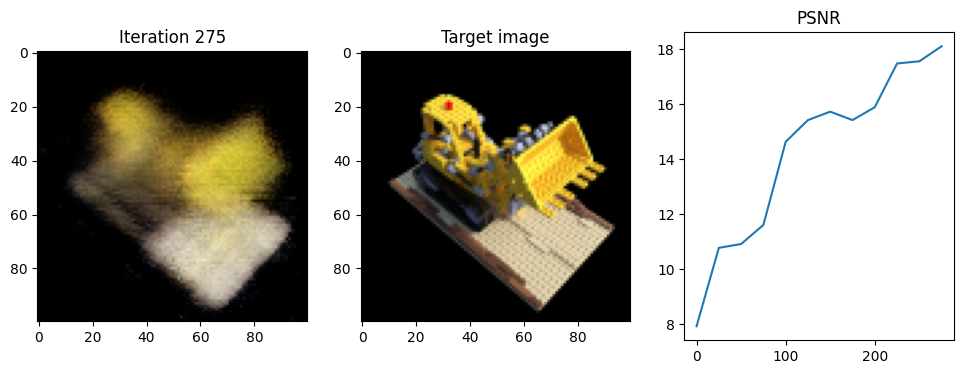

Iteration 300  Loss: 0.0141  PSNR: 18.51  Time: 1.02 secs per iter,  5.66 mins in total


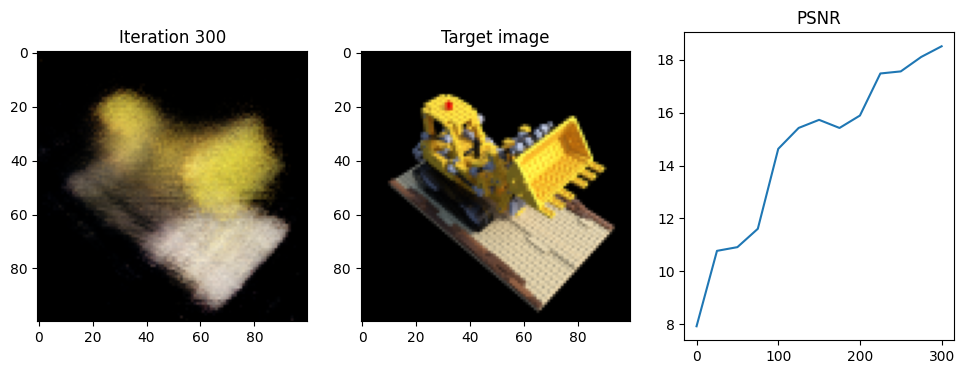

Iteration 325  Loss: 0.0136  PSNR: 18.67  Time: 1.03 secs per iter,  6.09 mins in total


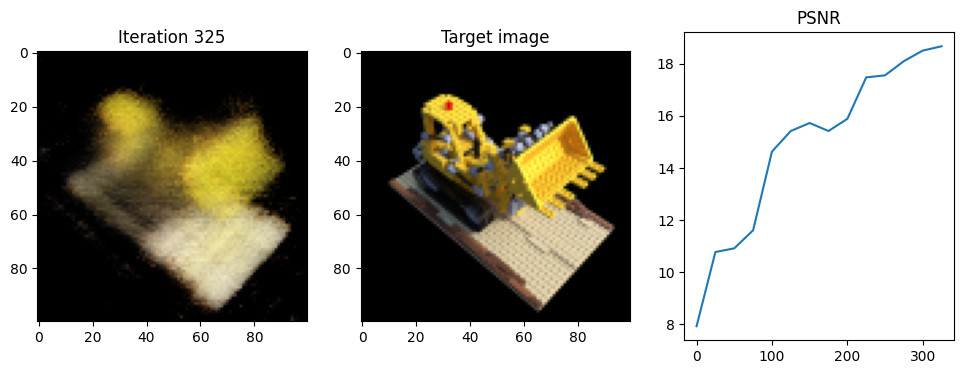

Iteration 350  Loss: 0.0113  PSNR: 19.46  Time: 1.03 secs per iter,  6.52 mins in total


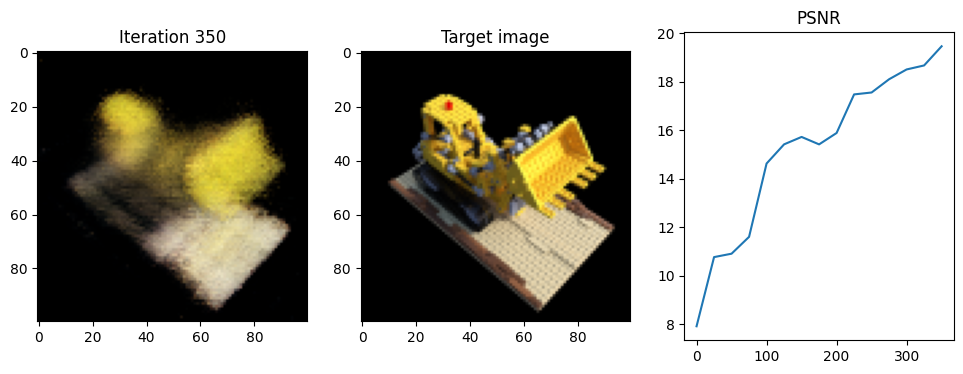

Iteration 375  Loss: 0.0113  PSNR: 19.45  Time: 1.02 secs per iter,  6.94 mins in total


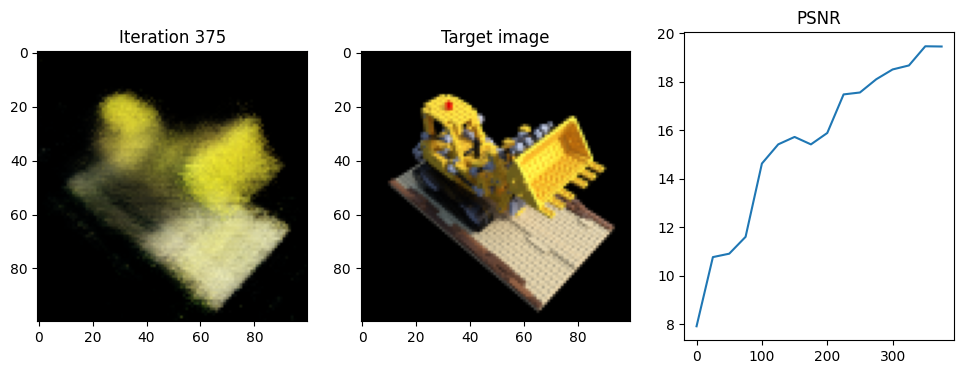

Iteration 400  Loss: 0.0105  PSNR: 19.80  Time: 1.01 secs per iter,  7.36 mins in total


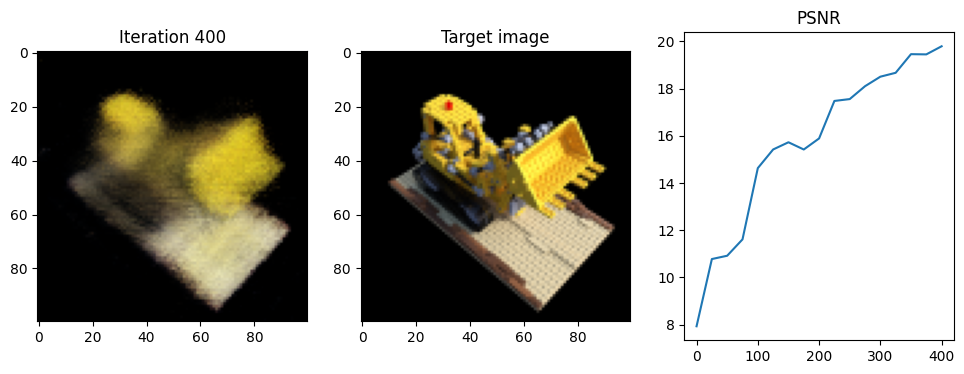

Iteration 425  Loss: 0.0115  PSNR: 19.38  Time: 1.01 secs per iter,  7.78 mins in total


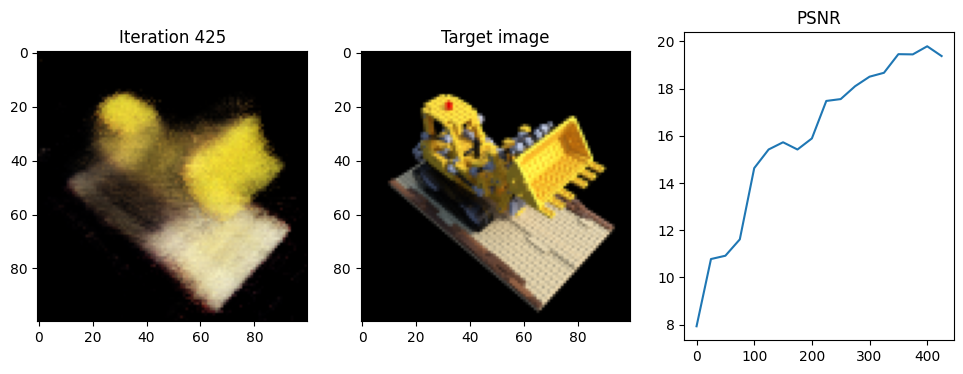

Iteration 450  Loss: 0.0100  PSNR: 20.02  Time: 1.01 secs per iter,  8.20 mins in total


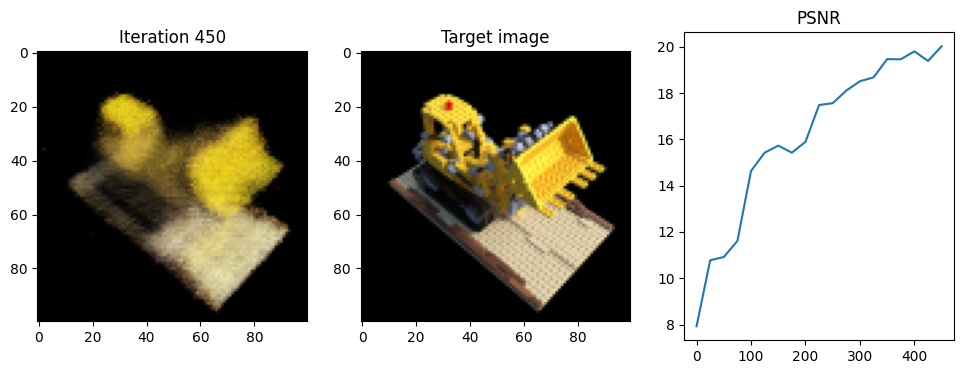

Iteration 475  Loss: 0.0101  PSNR: 19.94  Time: 1.01 secs per iter,  8.63 mins in total


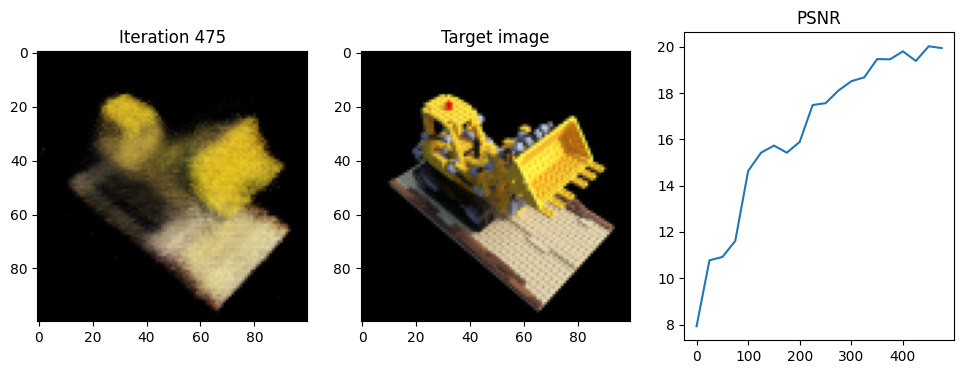

Iteration 500  Loss: 0.0096  PSNR: 20.16  Time: 1.01 secs per iter,  9.04 mins in total


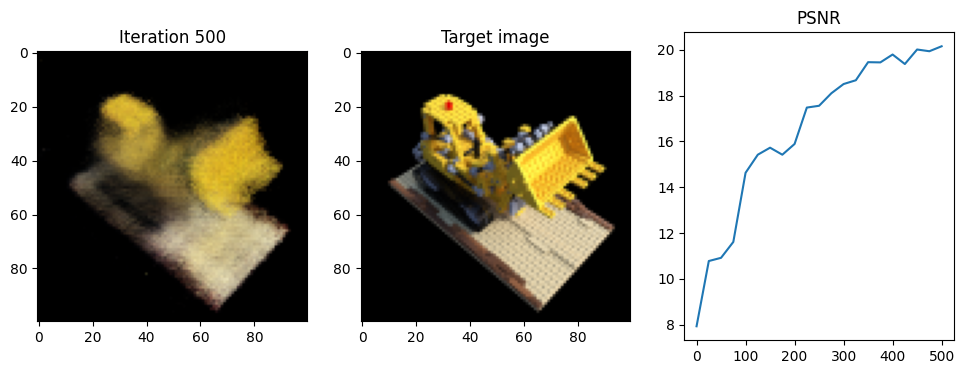

Iteration 525  Loss: 0.0090  PSNR: 20.46  Time: 1.01 secs per iter,  9.46 mins in total


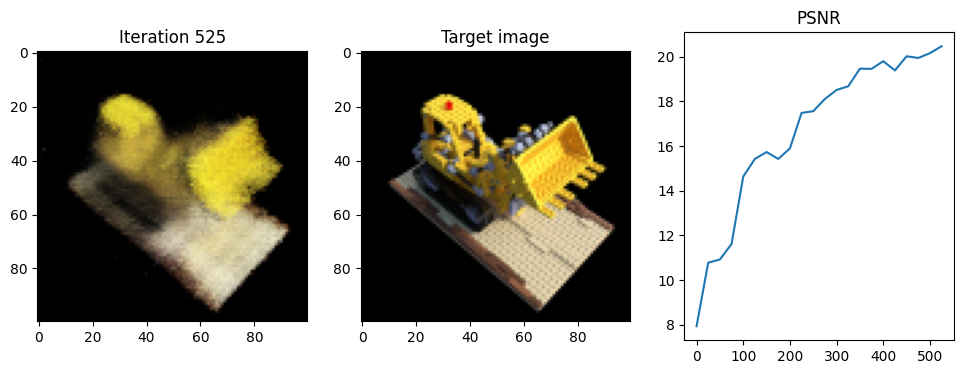

Iteration 550  Loss: 0.0089  PSNR: 20.52  Time: 1.01 secs per iter,  9.89 mins in total


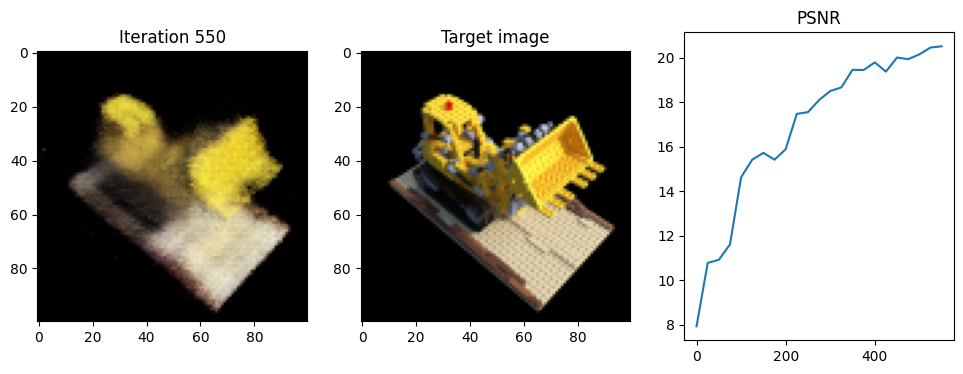

Iteration 575  Loss: 0.0083  PSNR: 20.79  Time: 1.01 secs per iter,  10.31 mins in total


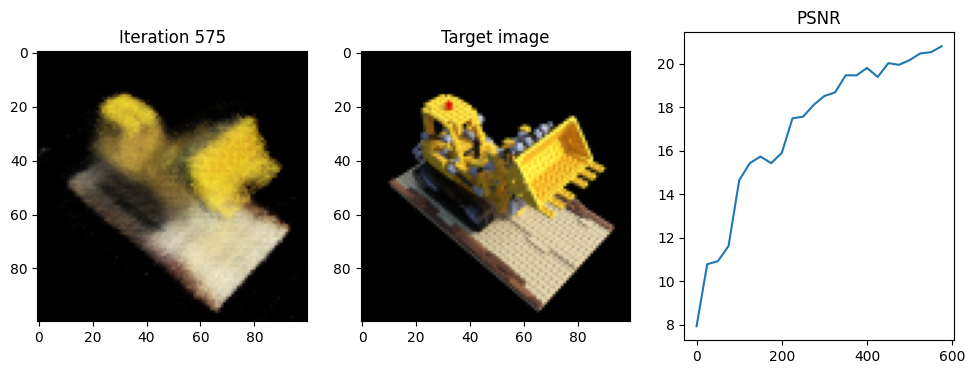

Iteration 600  Loss: 0.0092  PSNR: 20.36  Time: 1.01 secs per iter,  10.72 mins in total


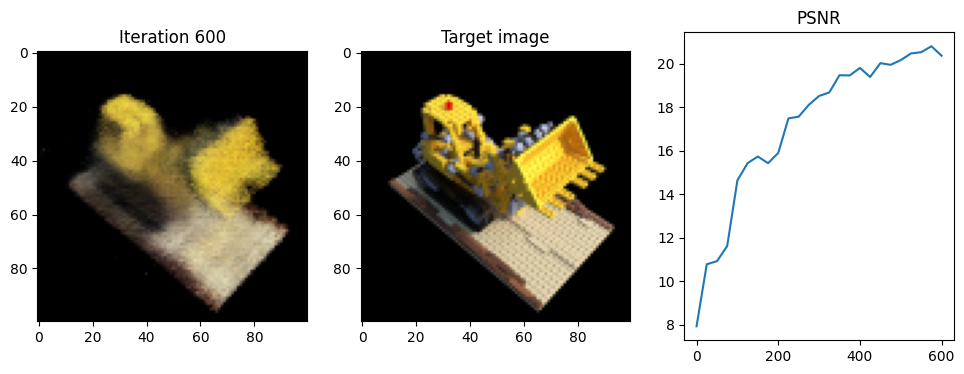

Iteration 625  Loss: 0.0093  PSNR: 20.33  Time: 1.00 secs per iter,  11.14 mins in total


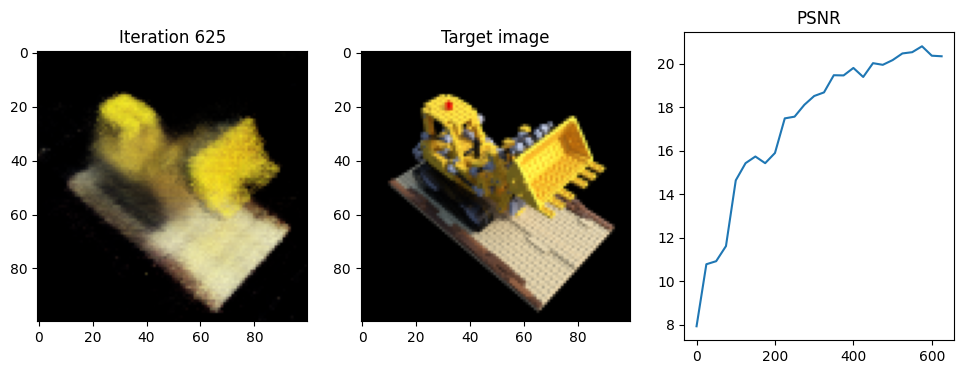

Iteration 650  Loss: 0.0088  PSNR: 20.57  Time: 1.01 secs per iter,  11.56 mins in total


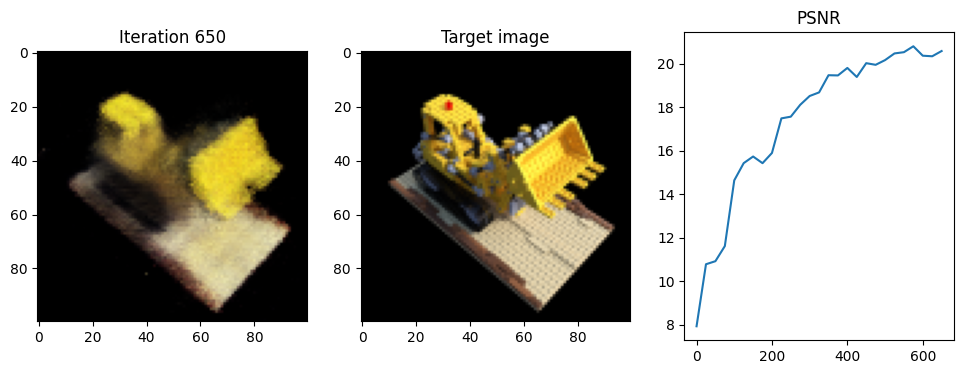

Iteration 675  Loss: 0.0079  PSNR: 21.00  Time: 1.00 secs per iter,  11.98 mins in total


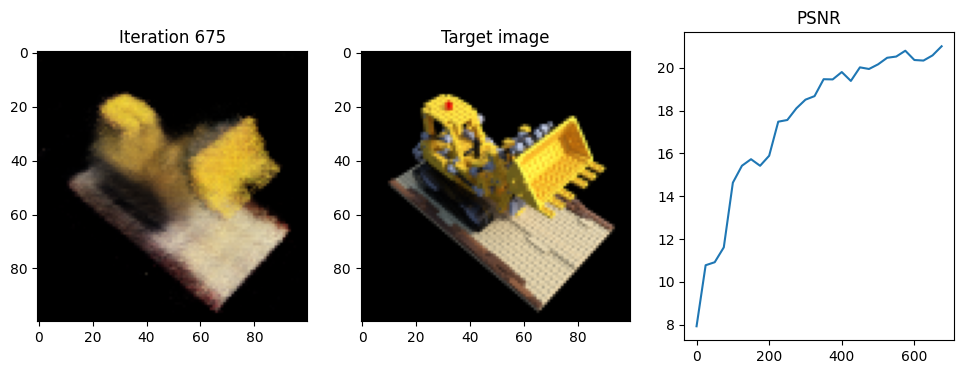

Iteration 700  Loss: 0.0080  PSNR: 20.95  Time: 1.00 secs per iter,  12.40 mins in total


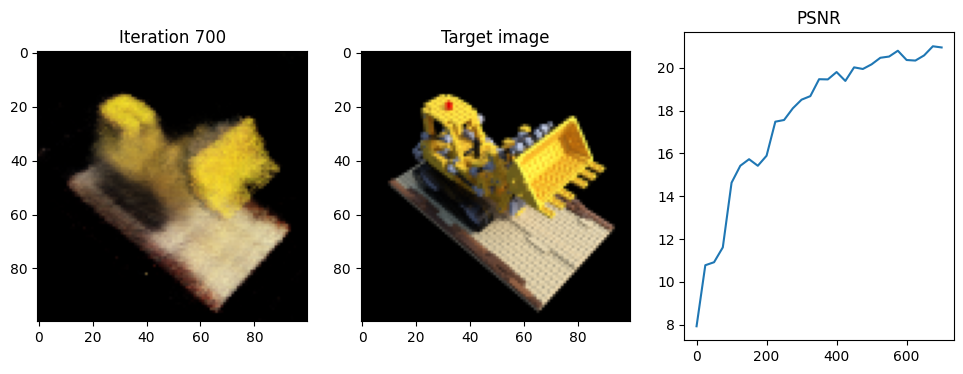

Iteration 725  Loss: 0.0081  PSNR: 20.91  Time: 1.00 secs per iter,  12.82 mins in total


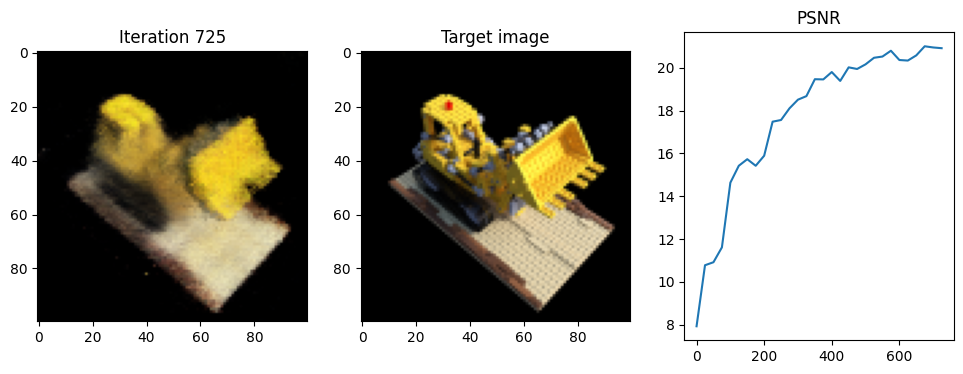

Iteration 750  Loss: 0.0080  PSNR: 20.96  Time: 1.01 secs per iter,  13.24 mins in total


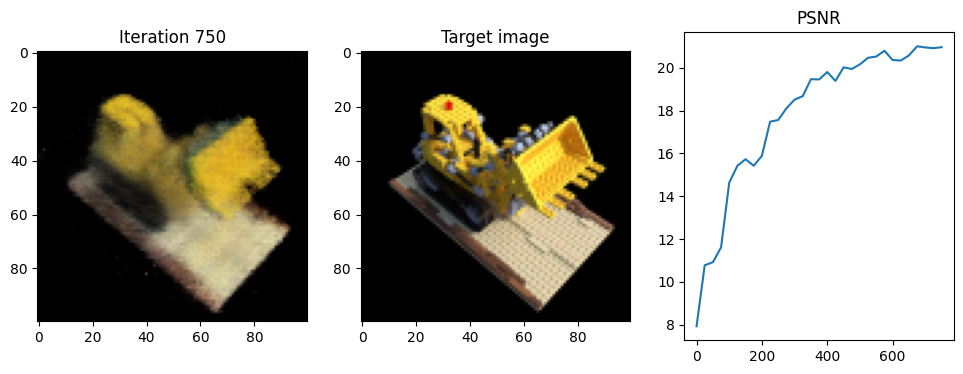

Iteration 775  Loss: 0.0079  PSNR: 21.05  Time: 1.01 secs per iter,  13.66 mins in total


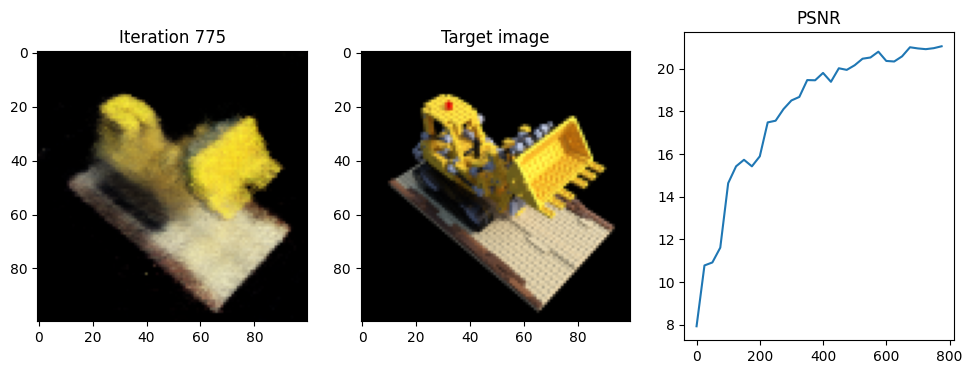

Iteration 800  Loss: 0.0075  PSNR: 21.25  Time: 1.01 secs per iter,  14.08 mins in total


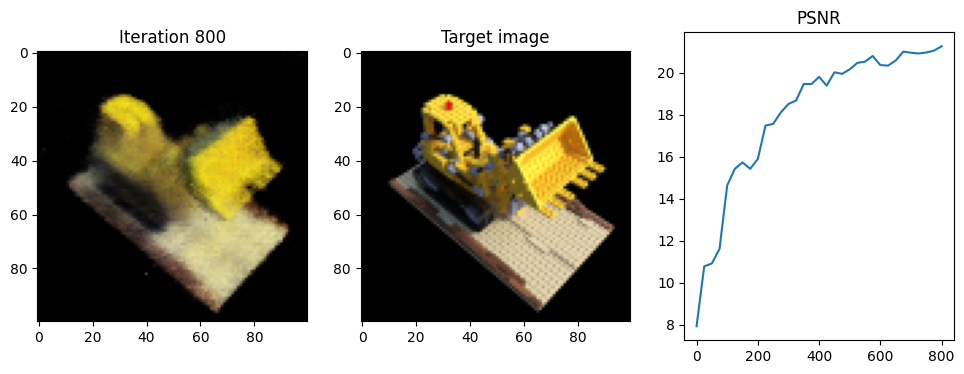

Iteration 825  Loss: 0.0072  PSNR: 21.42  Time: 1.02 secs per iter,  14.50 mins in total


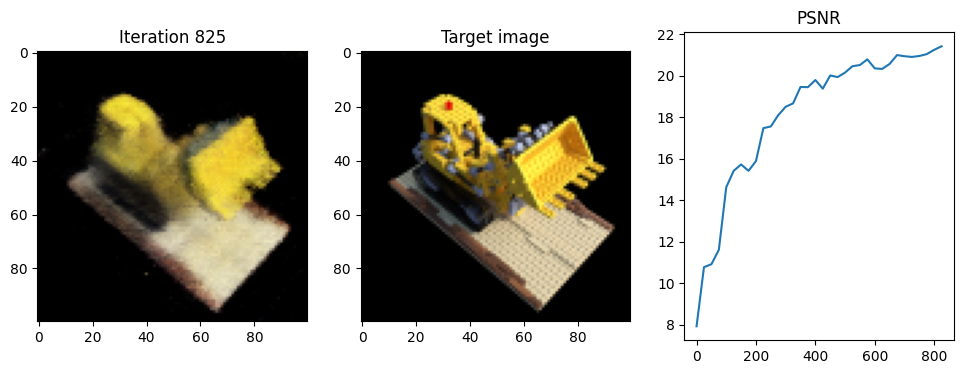

Iteration 850  Loss: 0.0069  PSNR: 21.64  Time: 1.01 secs per iter,  14.92 mins in total


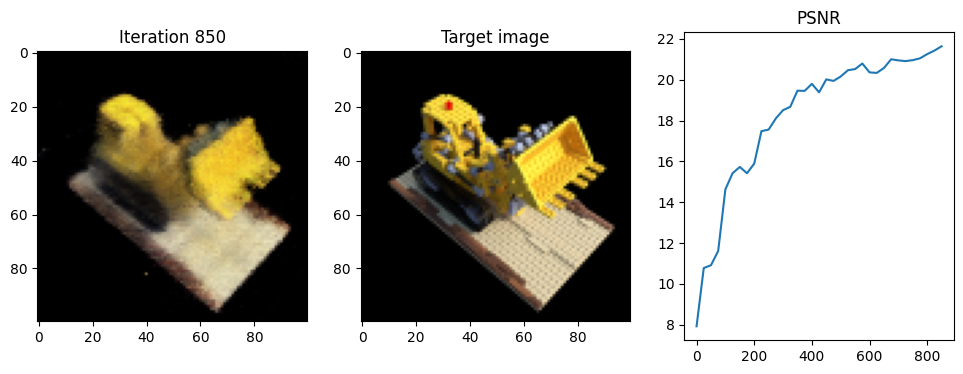

Iteration 875  Loss: 0.0068  PSNR: 21.70  Time: 1.00 secs per iter,  15.34 mins in total


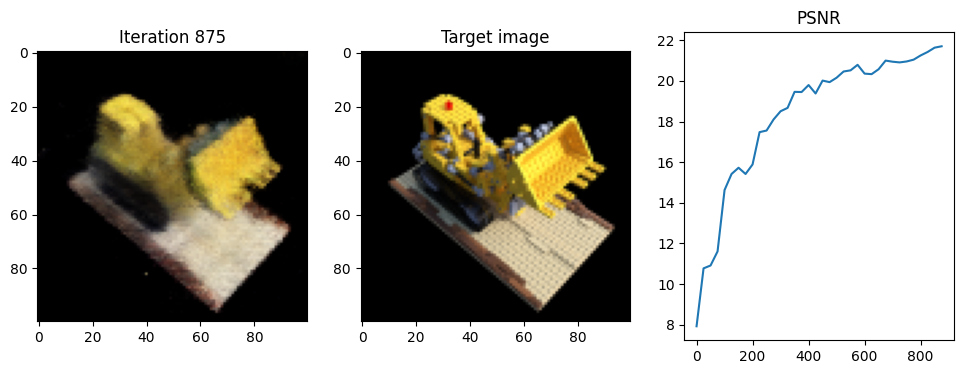

Iteration 900  Loss: 0.0075  PSNR: 21.24  Time: 1.00 secs per iter,  15.76 mins in total


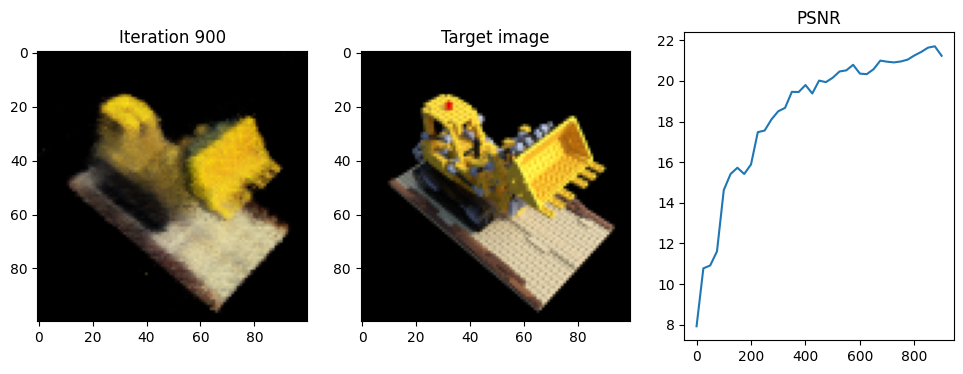

Iteration 925  Loss: 0.0067  PSNR: 21.77  Time: 1.00 secs per iter,  16.18 mins in total


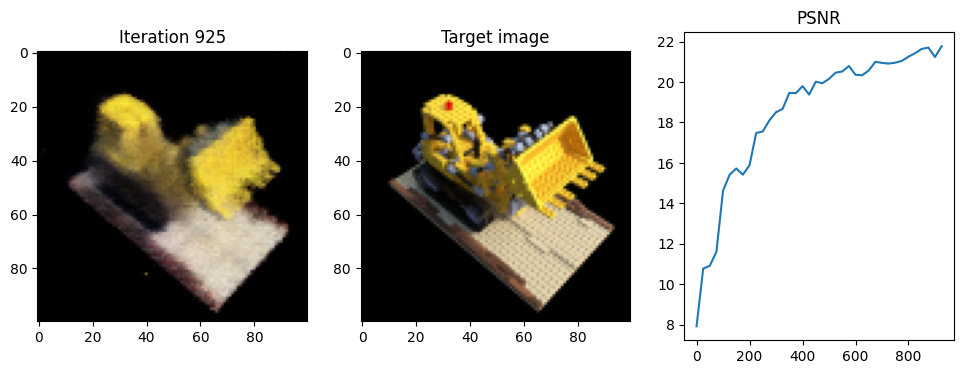

Iteration 950  Loss: 0.0069  PSNR: 21.63  Time: 1.01 secs per iter,  16.60 mins in total


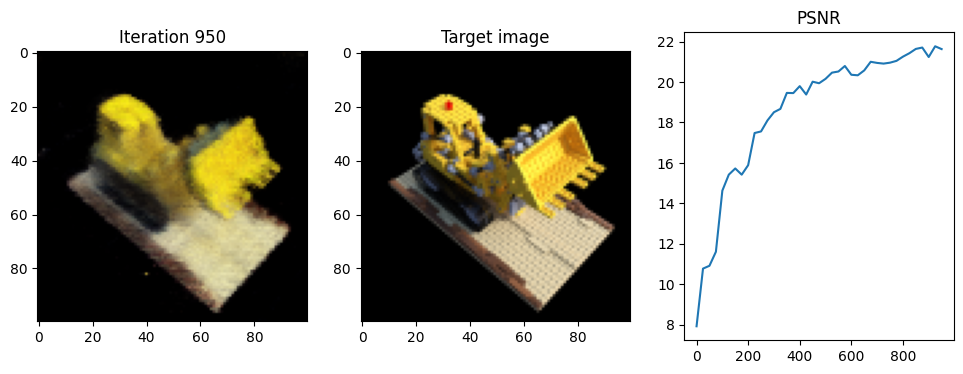

Iteration 975  Loss: 0.0078  PSNR: 21.09  Time: 1.00 secs per iter,  17.02 mins in total


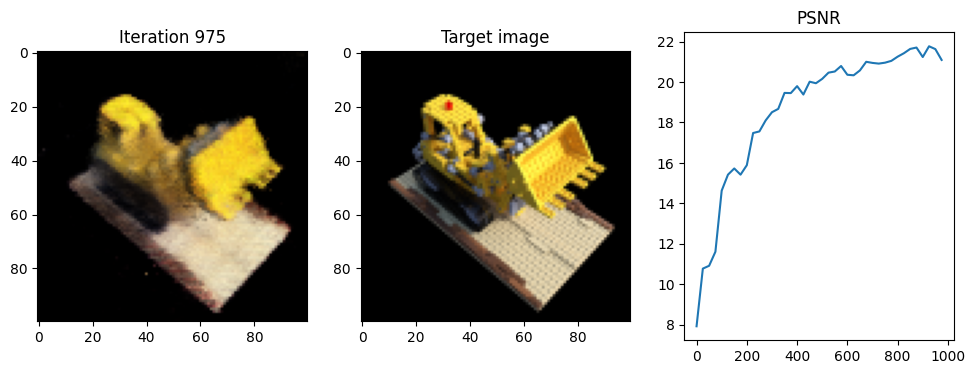

Iteration 1000  Loss: 0.0060  PSNR: 22.19  Time: 1.00 secs per iter,  17.44 mins in total


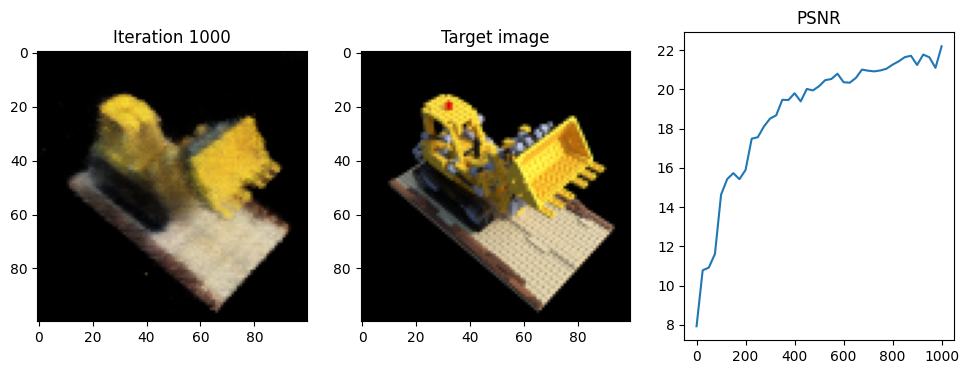

Iteration 1025  Loss: 0.0064  PSNR: 21.96  Time: 1.00 secs per iter,  17.85 mins in total


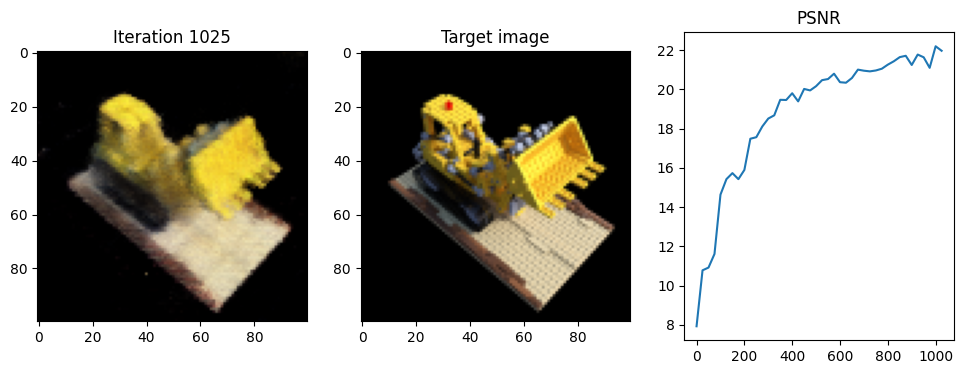

Iteration 1050  Loss: 0.0063  PSNR: 22.03  Time: 1.00 secs per iter,  18.27 mins in total


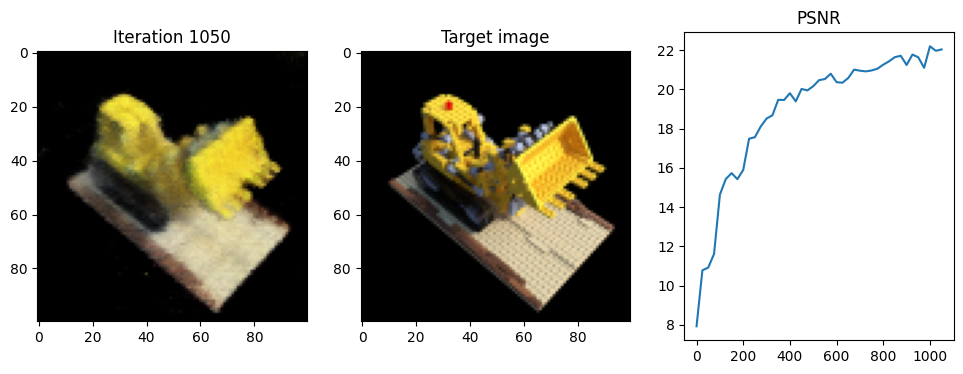

Iteration 1075  Loss: 0.0062  PSNR: 22.06  Time: 1.00 secs per iter,  18.69 mins in total


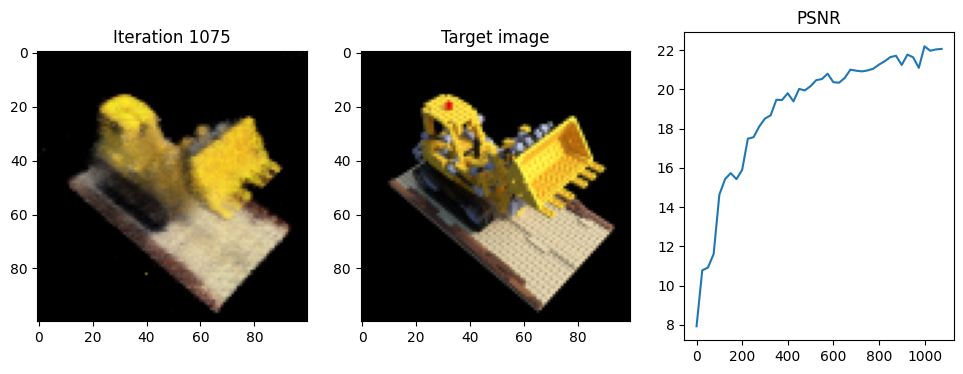

Iteration 1100  Loss: 0.0059  PSNR: 22.31  Time: 1.00 secs per iter,  19.11 mins in total


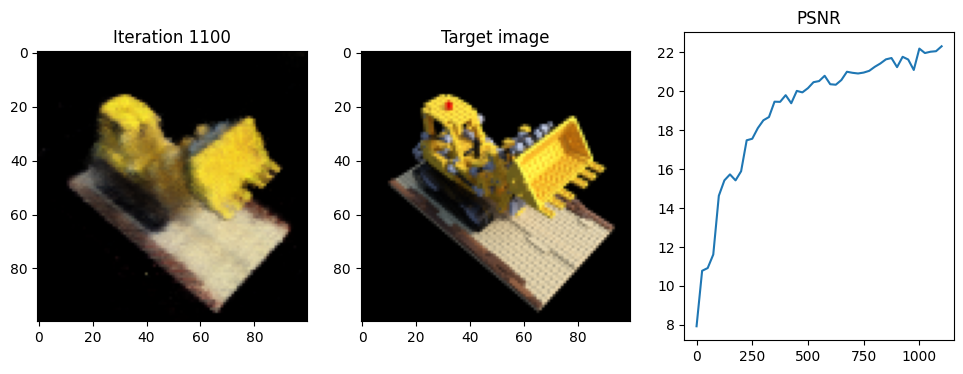

Iteration 1125  Loss: 0.0058  PSNR: 22.35  Time: 1.01 secs per iter,  19.53 mins in total


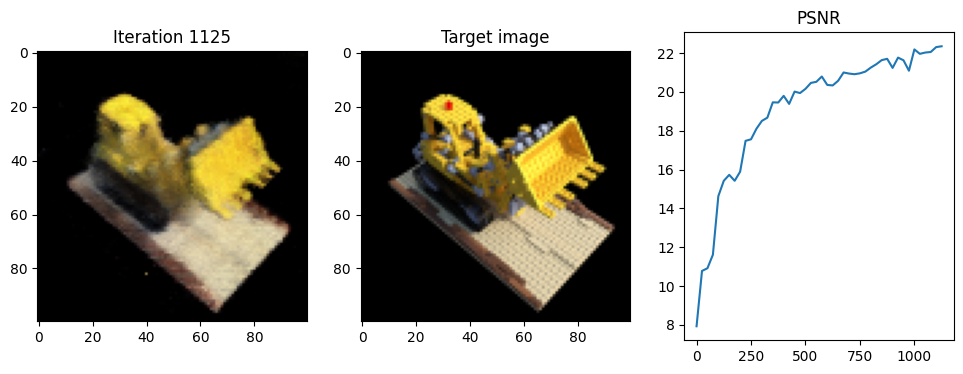

Iteration 1150  Loss: 0.0056  PSNR: 22.55  Time: 1.00 secs per iter,  19.94 mins in total


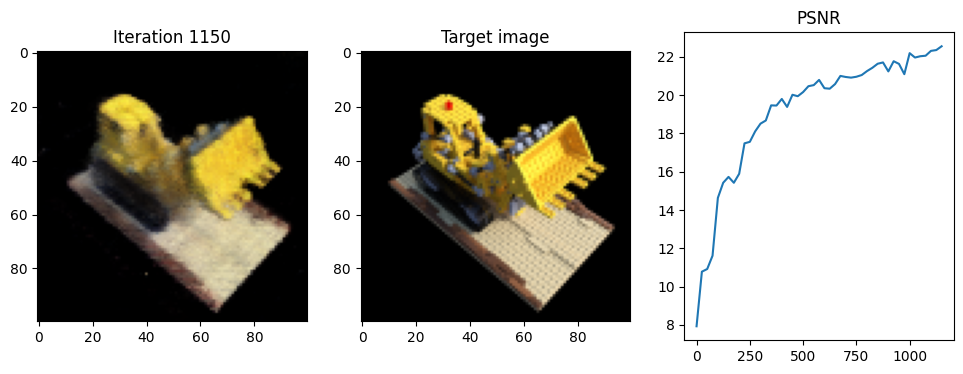

Iteration 1175  Loss: 0.0061  PSNR: 22.12  Time: 1.00 secs per iter,  20.36 mins in total


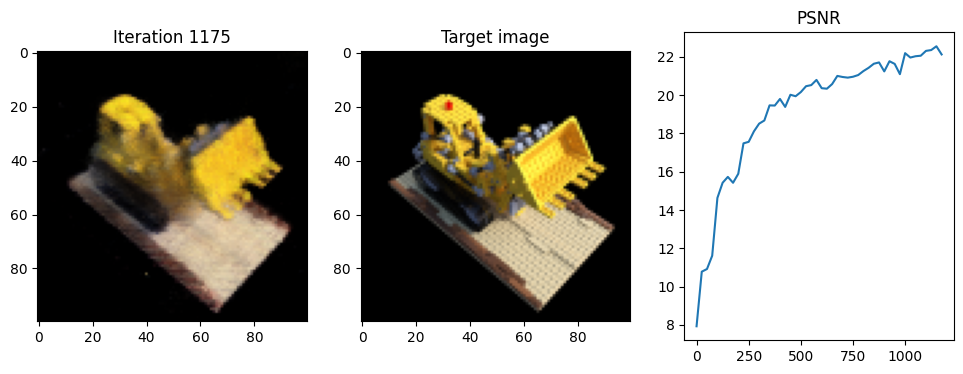

Iteration 1200  Loss: 0.0051  PSNR: 22.90  Time: 1.00 secs per iter,  20.78 mins in total


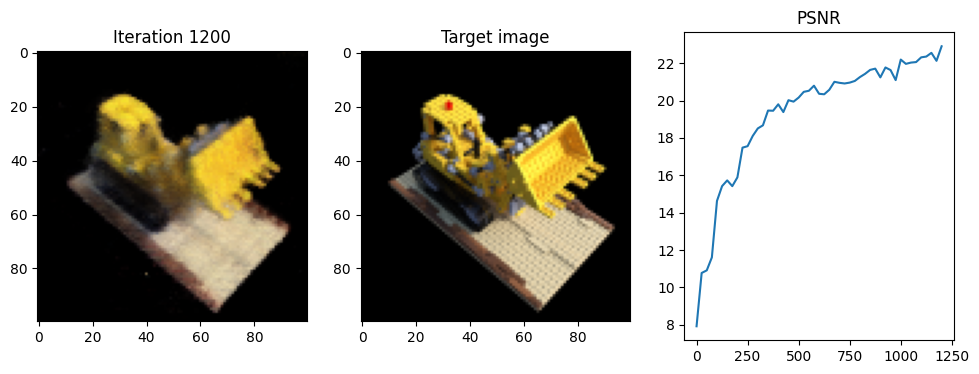

Iteration 1225  Loss: 0.0054  PSNR: 22.65  Time: 1.00 secs per iter,  21.20 mins in total


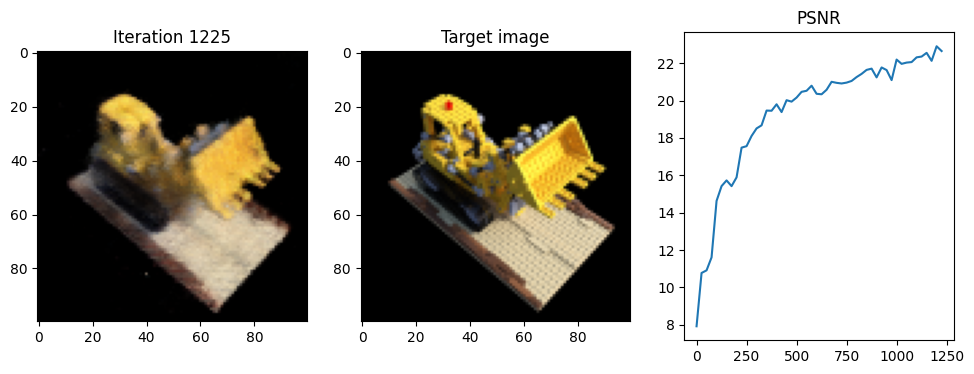

Iteration 1250  Loss: 0.0057  PSNR: 22.47  Time: 1.00 secs per iter,  21.62 mins in total


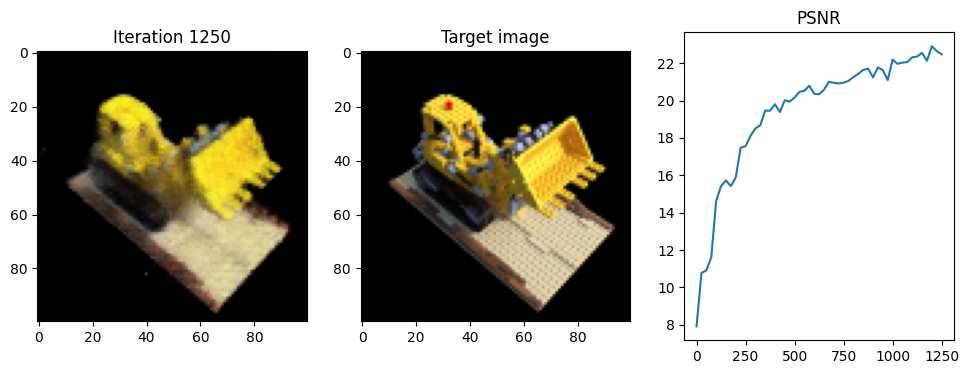

Iteration 1275  Loss: 0.0057  PSNR: 22.41  Time: 1.00 secs per iter,  22.03 mins in total


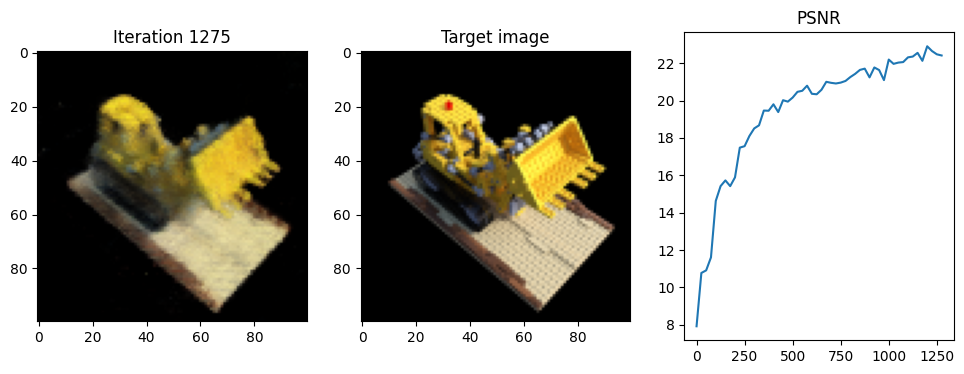

Iteration 1300  Loss: 0.0051  PSNR: 22.91  Time: 1.01 secs per iter,  22.45 mins in total


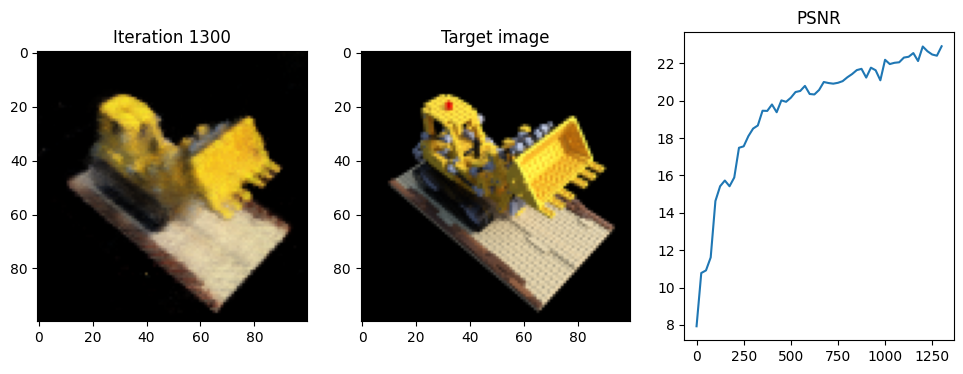

Iteration 1325  Loss: 0.0049  PSNR: 23.08  Time: 1.01 secs per iter,  22.88 mins in total


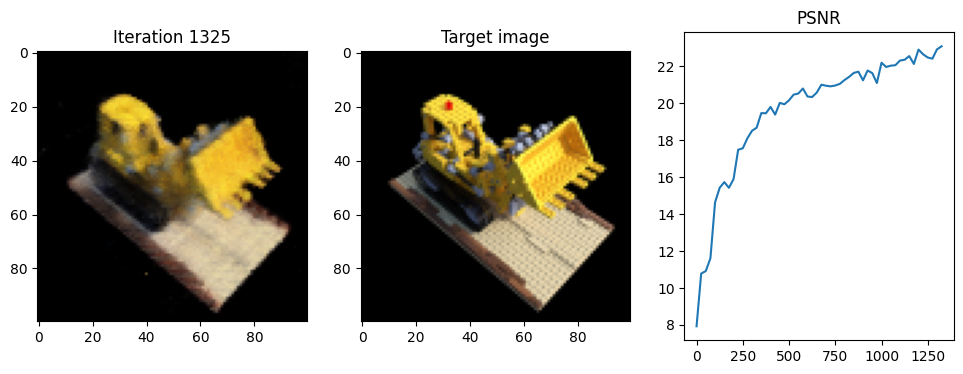

Iteration 1350  Loss: 0.0050  PSNR: 23.02  Time: 1.01 secs per iter,  23.30 mins in total


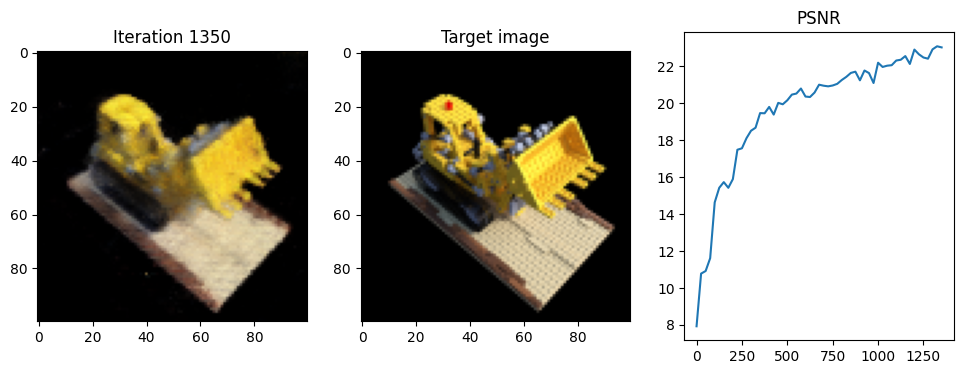

Iteration 1375  Loss: 0.0050  PSNR: 22.98  Time: 1.01 secs per iter,  23.72 mins in total


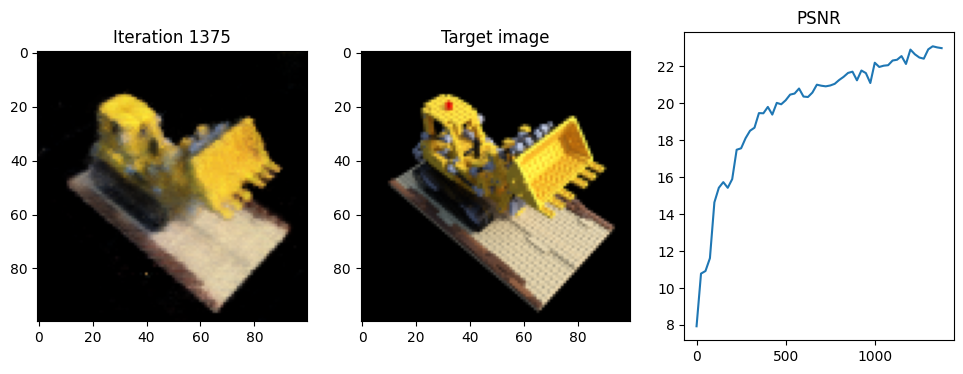

Iteration 1400  Loss: 0.0048  PSNR: 23.17  Time: 1.01 secs per iter,  24.14 mins in total


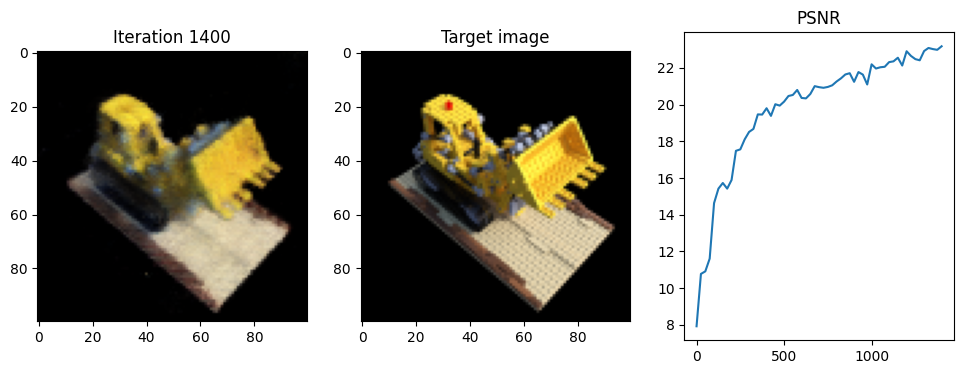

Iteration 1425  Loss: 0.0052  PSNR: 22.85  Time: 1.01 secs per iter,  24.56 mins in total


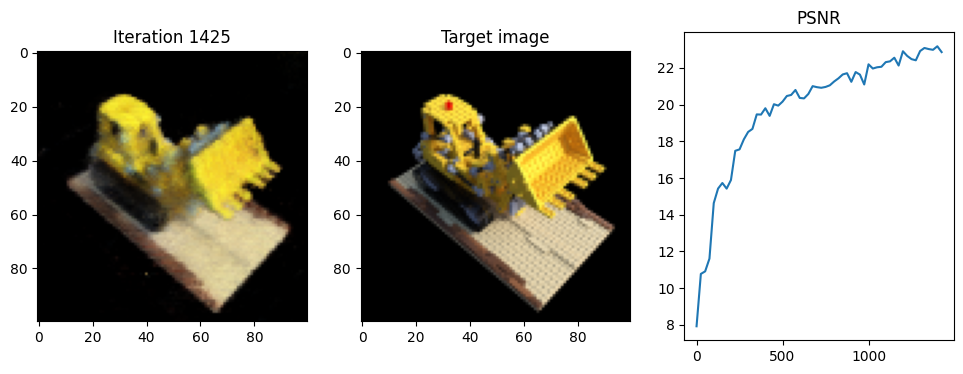

Iteration 1450  Loss: 0.0048  PSNR: 23.20  Time: 1.00 secs per iter,  24.98 mins in total


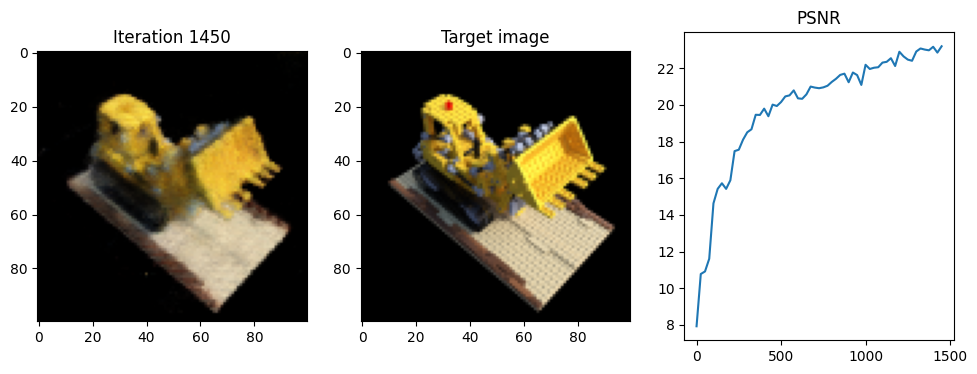

Iteration 1475  Loss: 0.0048  PSNR: 23.23  Time: 1.00 secs per iter,  25.39 mins in total


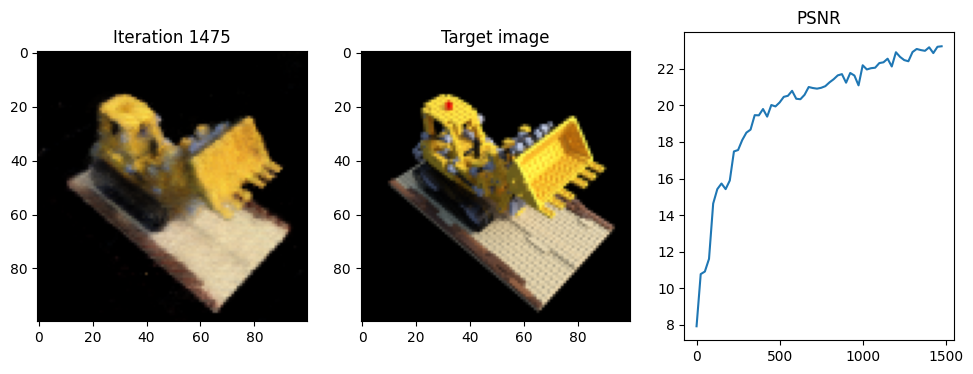

Iteration 1500  Loss: 0.0045  PSNR: 23.50  Time: 1.01 secs per iter,  25.81 mins in total


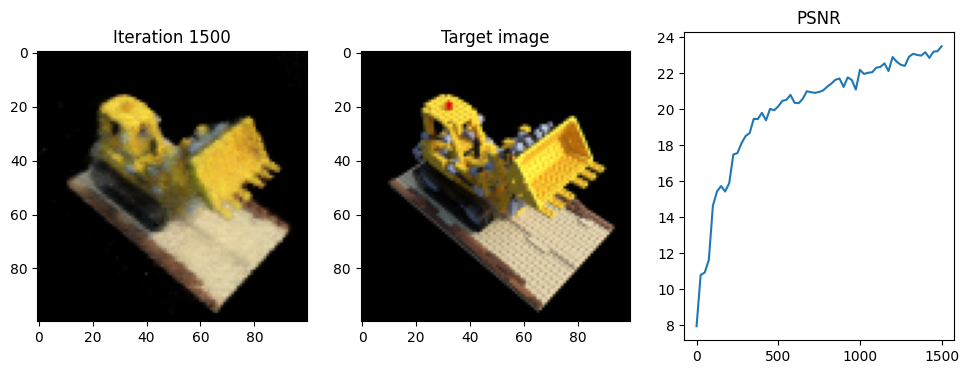

Iteration 1525  Loss: 0.0044  PSNR: 23.61  Time: 1.00 secs per iter,  26.23 mins in total


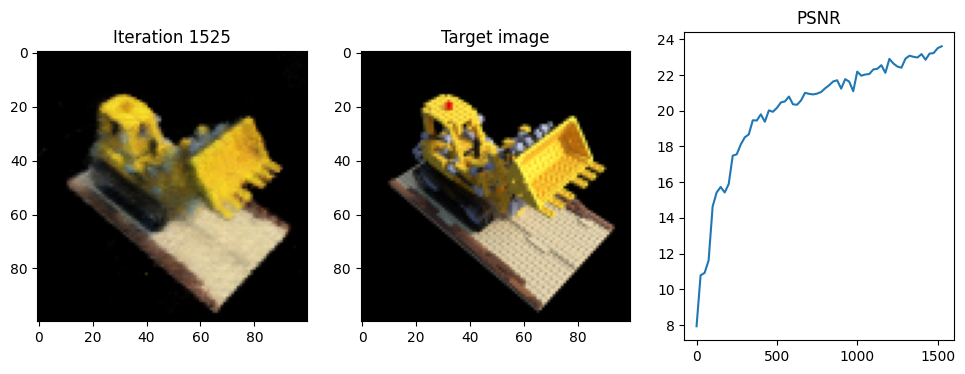

Iteration 1550  Loss: 0.0043  PSNR: 23.62  Time: 1.00 secs per iter,  26.65 mins in total


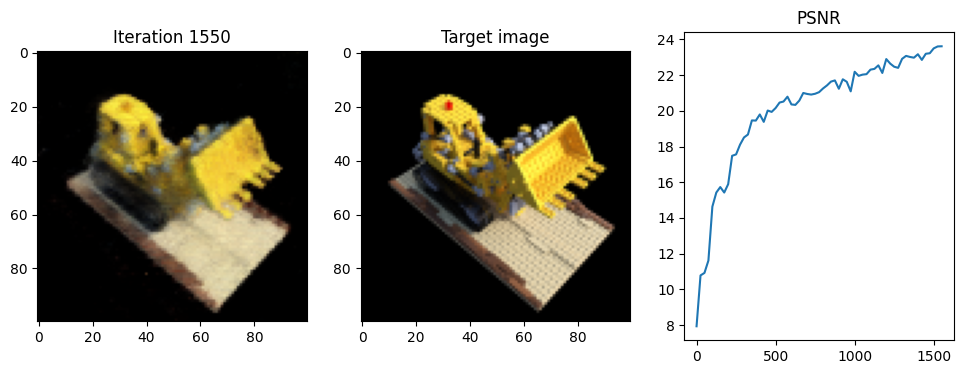

Iteration 1575  Loss: 0.0048  PSNR: 23.15  Time: 1.00 secs per iter,  27.06 mins in total


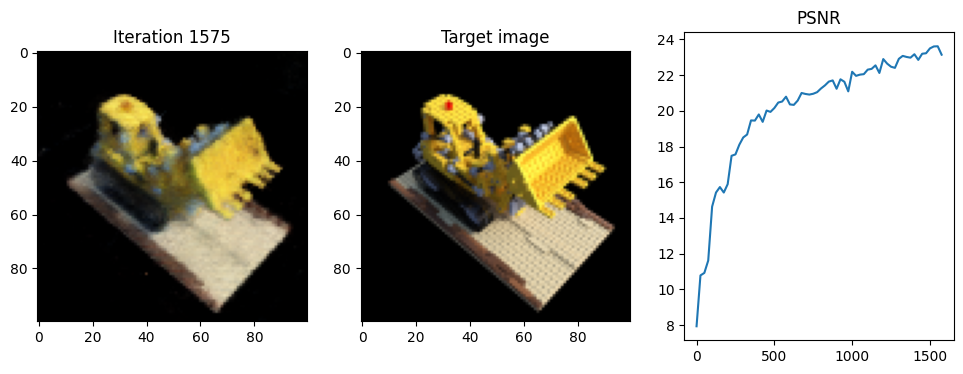

Iteration 1600  Loss: 0.0048  PSNR: 23.17  Time: 1.00 secs per iter,  27.48 mins in total


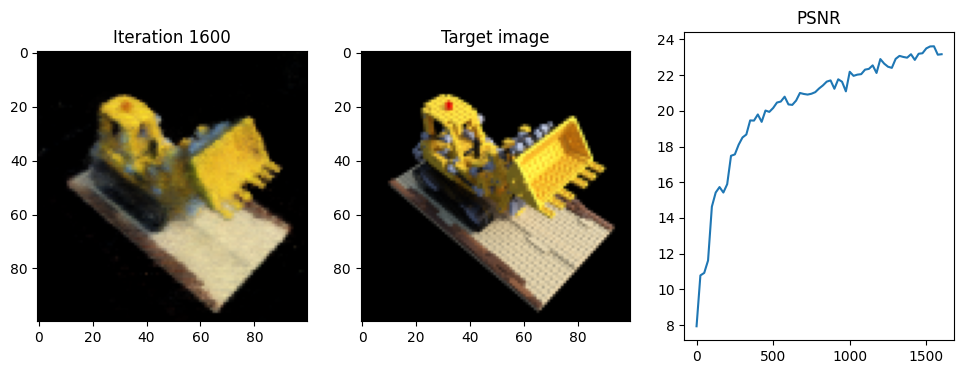

Iteration 1625  Loss: 0.0045  PSNR: 23.49  Time: 1.00 secs per iter,  27.90 mins in total


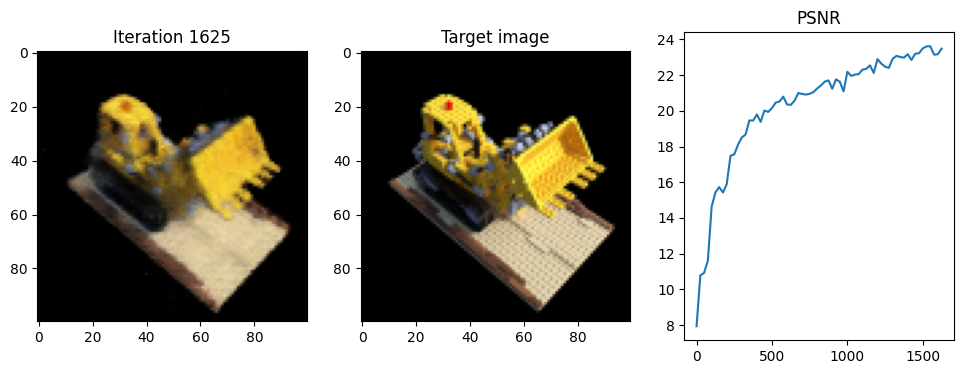

Iteration 1650  Loss: 0.0043  PSNR: 23.68  Time: 1.00 secs per iter,  28.32 mins in total


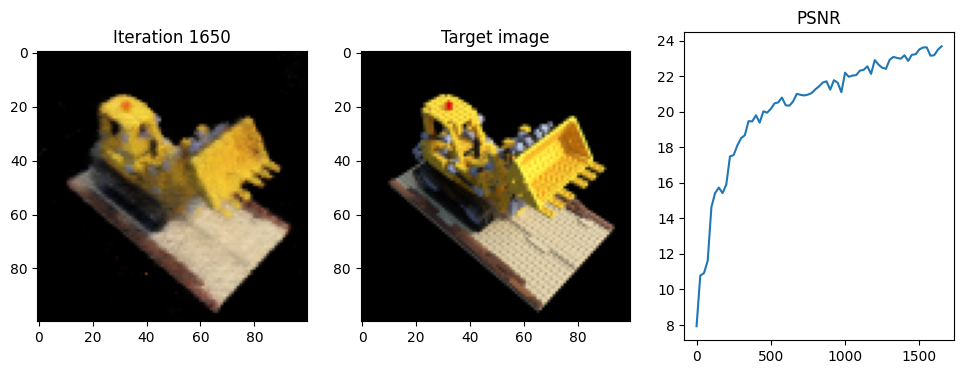

Iteration 1675  Loss: 0.0045  PSNR: 23.47  Time: 1.00 secs per iter,  28.73 mins in total


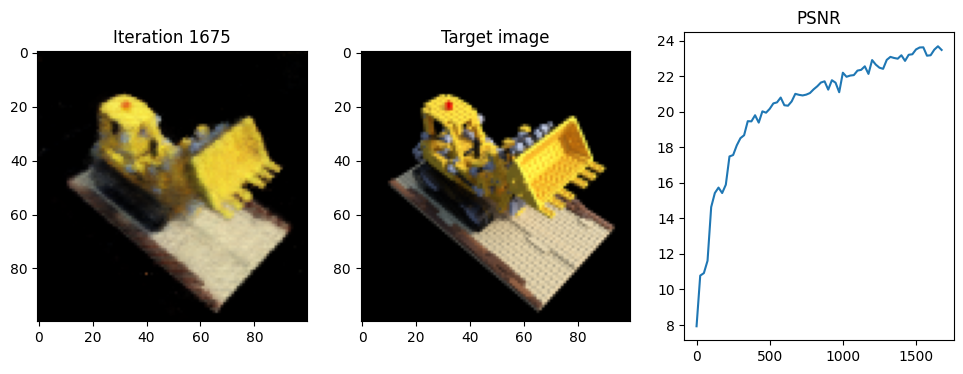

Iteration 1700  Loss: 0.0044  PSNR: 23.56  Time: 1.01 secs per iter,  29.15 mins in total


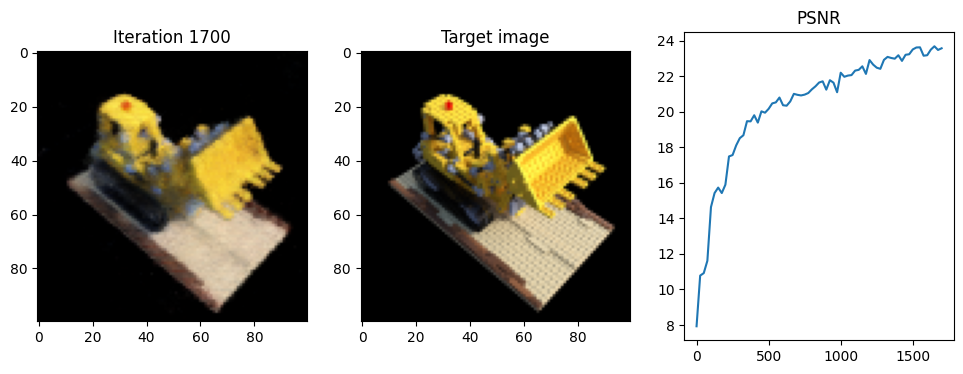

Iteration 1725  Loss: 0.0046  PSNR: 23.40  Time: 1.00 secs per iter,  29.57 mins in total


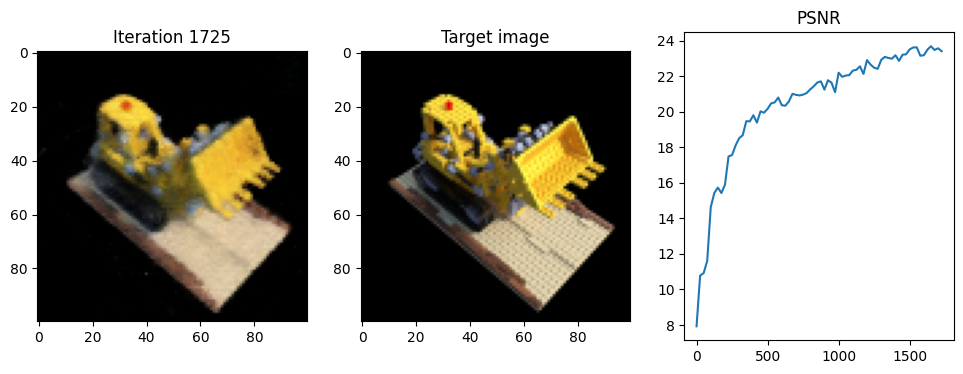

Iteration 1750  Loss: 0.0046  PSNR: 23.42  Time: 1.00 secs per iter,  29.99 mins in total


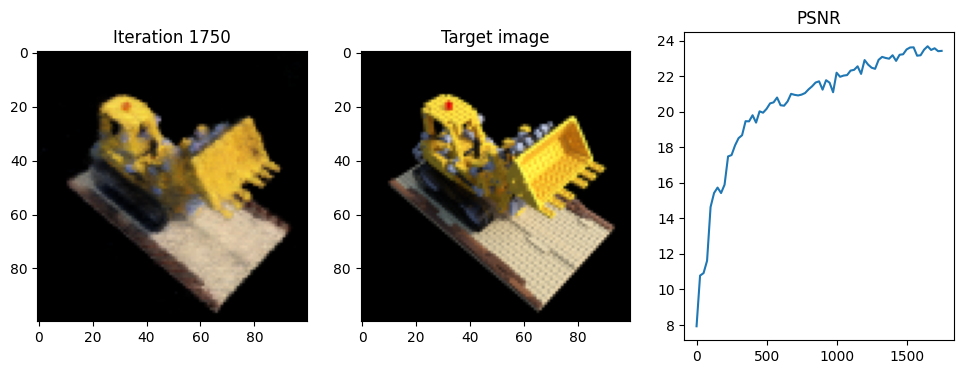

Iteration 1775  Loss: 0.0042  PSNR: 23.78  Time: 1.00 secs per iter,  30.41 mins in total


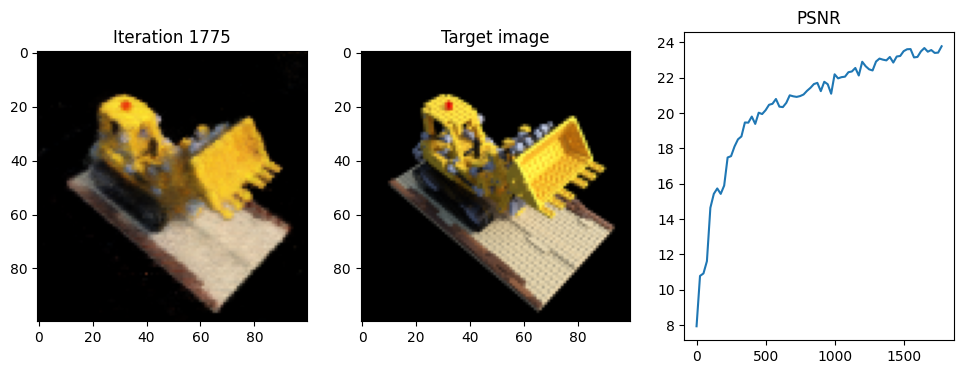

Iteration 1800  Loss: 0.0049  PSNR: 23.06  Time: 1.00 secs per iter,  30.82 mins in total


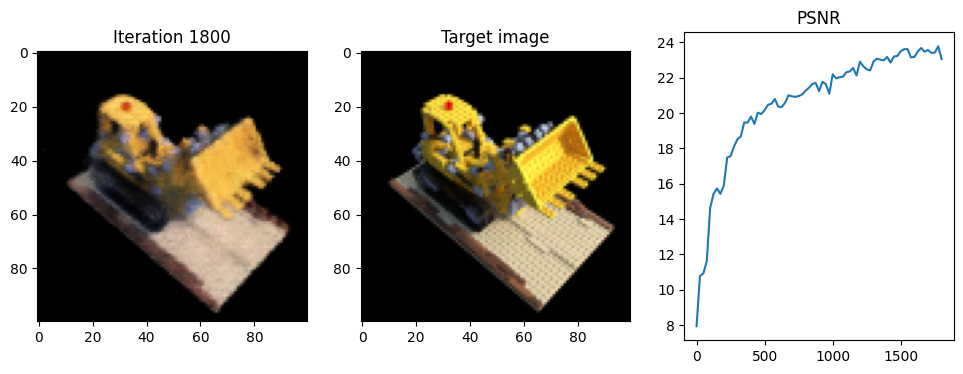

Iteration 1825  Loss: 0.0042  PSNR: 23.72  Time: 1.00 secs per iter,  31.24 mins in total


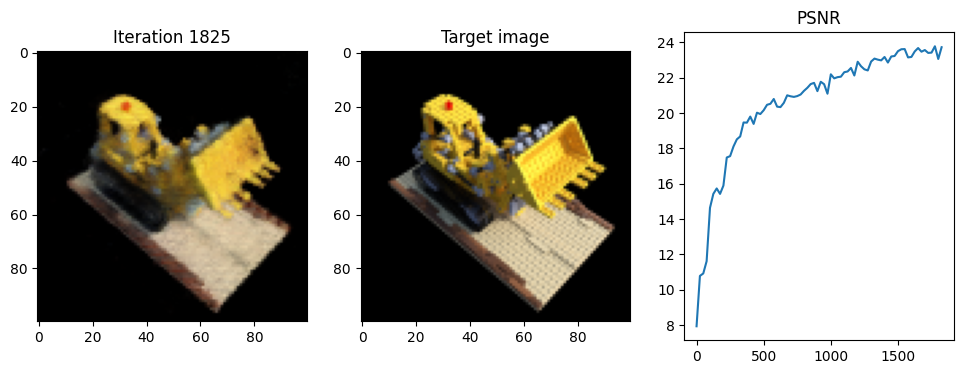

Iteration 1850  Loss: 0.0044  PSNR: 23.56  Time: 1.00 secs per iter,  31.66 mins in total


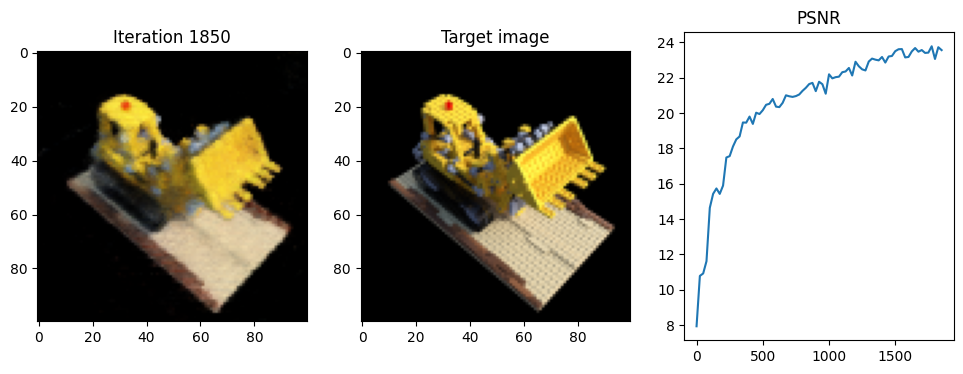

Iteration 1875  Loss: 0.0041  PSNR: 23.92  Time: 1.01 secs per iter,  32.08 mins in total


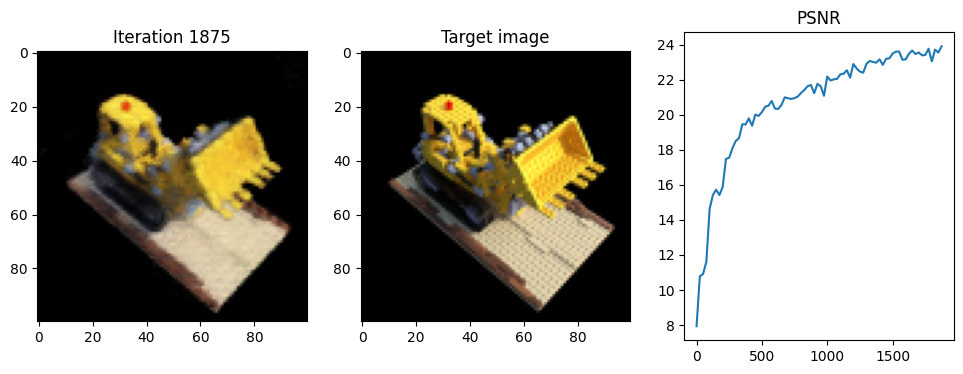

Iteration 1900  Loss: 0.0049  PSNR: 23.07  Time: 1.00 secs per iter,  32.50 mins in total


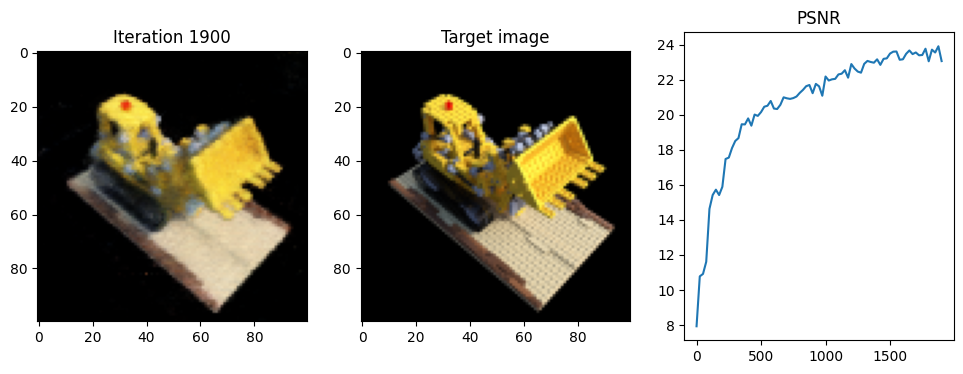

Iteration 1925  Loss: 0.0043  PSNR: 23.71  Time: 1.01 secs per iter,  32.91 mins in total


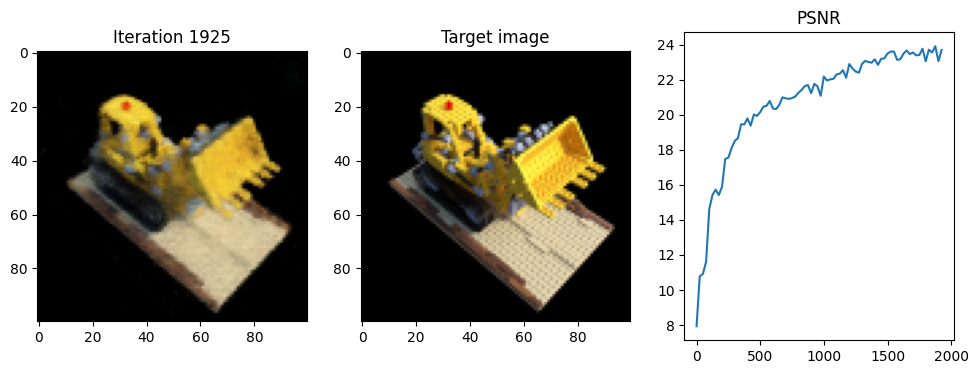

Iteration 1950  Loss: 0.0037  PSNR: 24.31  Time: 1.01 secs per iter,  33.33 mins in total


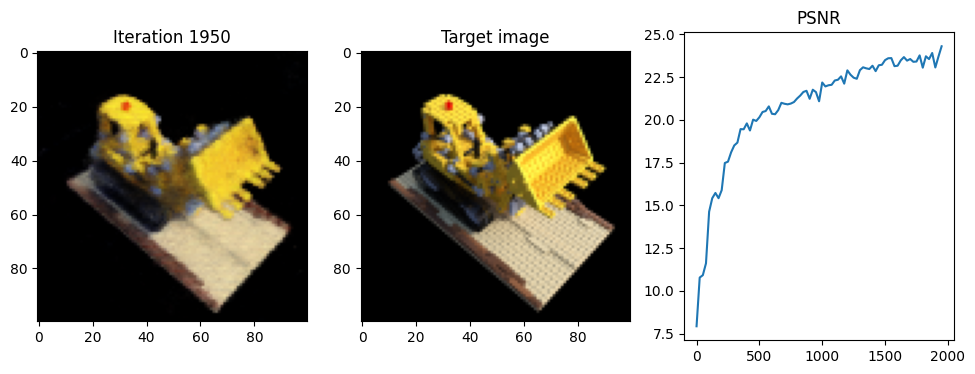

Iteration 1975  Loss: 0.0041  PSNR: 23.92  Time: 1.01 secs per iter,  33.76 mins in total


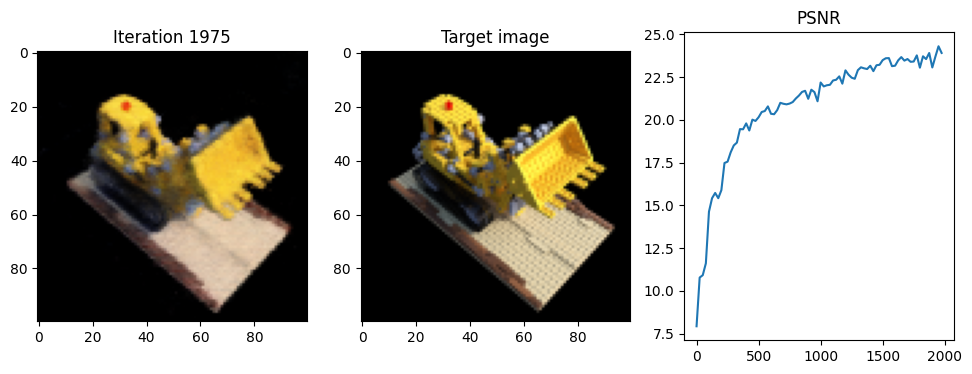

Iteration 2000  Loss: 0.0043  PSNR: 23.68  Time: 1.01 secs per iter,  34.17 mins in total


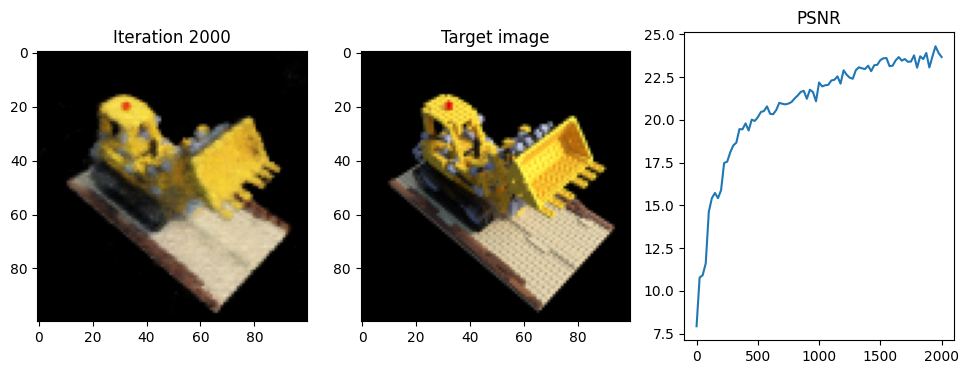

Iteration 2025  Loss: 0.0043  PSNR: 23.66  Time: 1.01 secs per iter,  34.60 mins in total


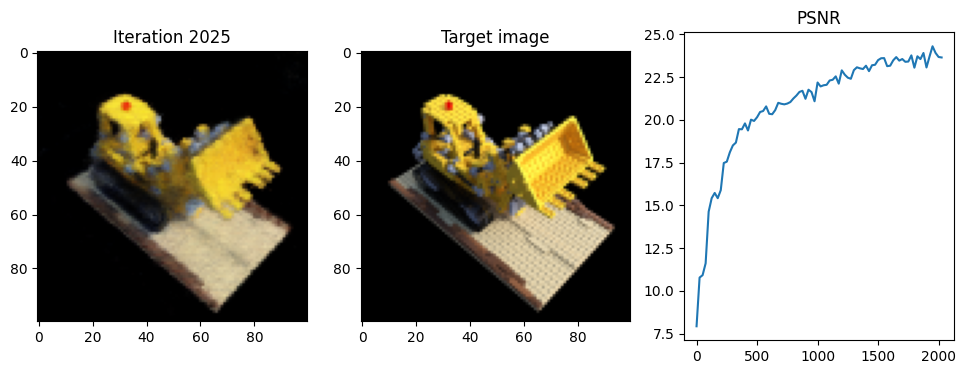

Iteration 2050  Loss: 0.0044  PSNR: 23.58  Time: 1.01 secs per iter,  35.02 mins in total


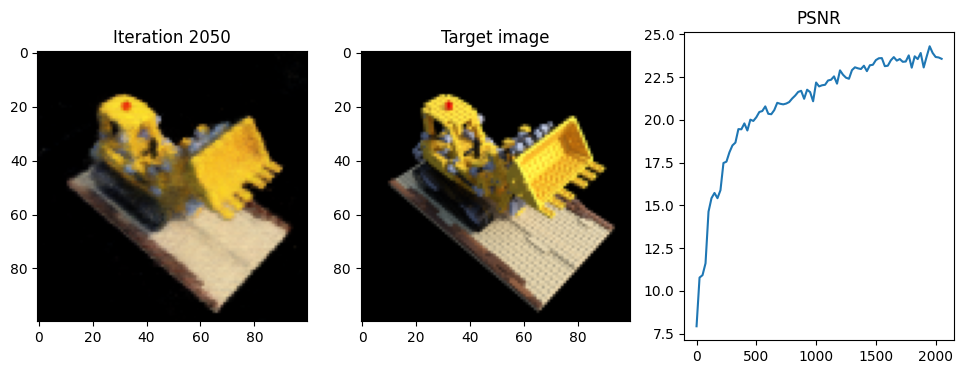

Iteration 2075  Loss: 0.0039  PSNR: 24.14  Time: 1.02 secs per iter,  35.44 mins in total


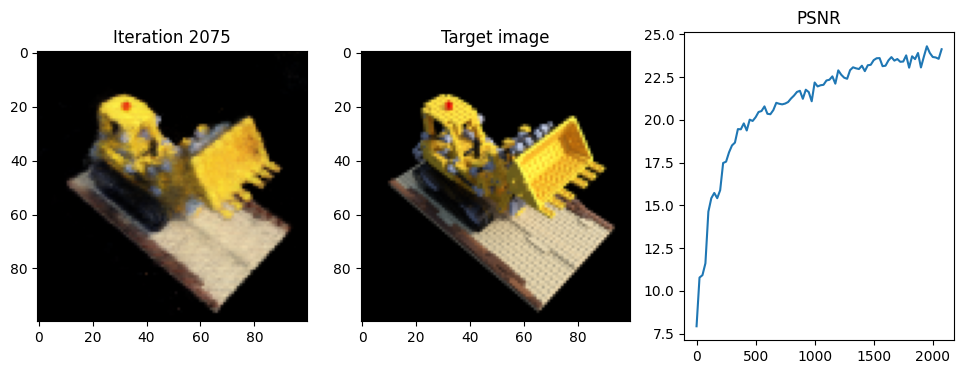

Iteration 2100  Loss: 0.0049  PSNR: 23.13  Time: 1.01 secs per iter,  35.86 mins in total


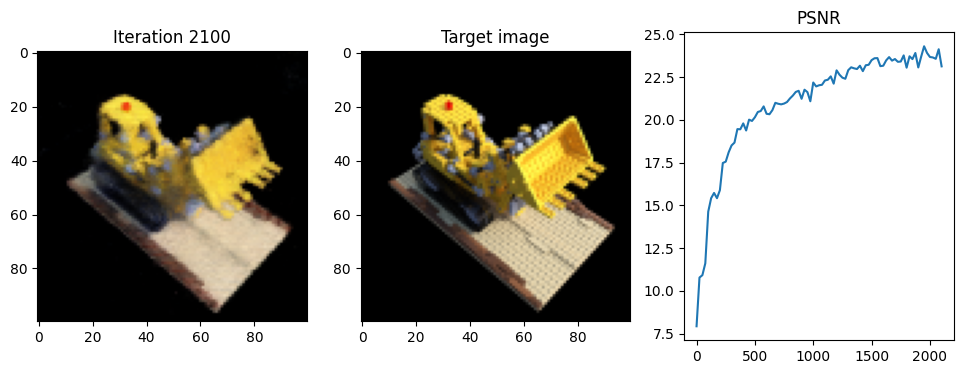

Iteration 2125  Loss: 0.0037  PSNR: 24.27  Time: 1.00 secs per iter,  36.28 mins in total


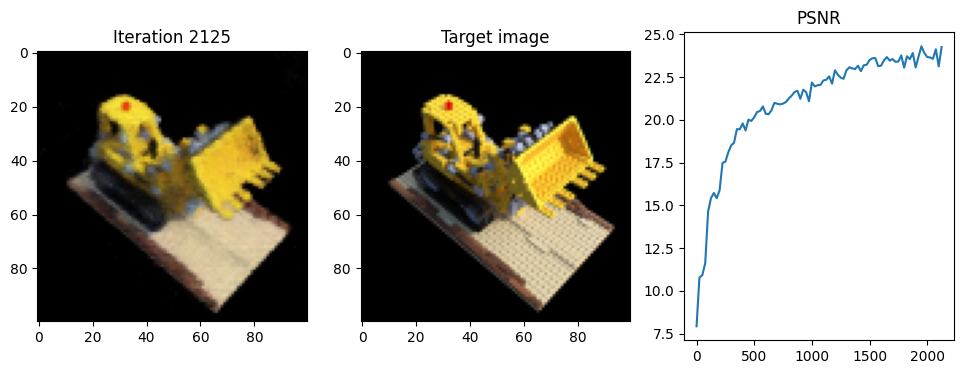

Iteration 2150  Loss: 0.0037  PSNR: 24.28  Time: 1.00 secs per iter,  36.70 mins in total


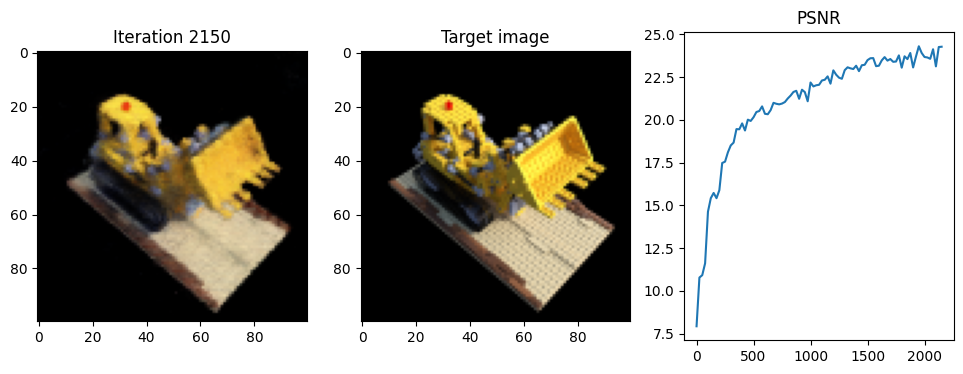

Iteration 2175  Loss: 0.0045  PSNR: 23.42  Time: 1.00 secs per iter,  37.11 mins in total


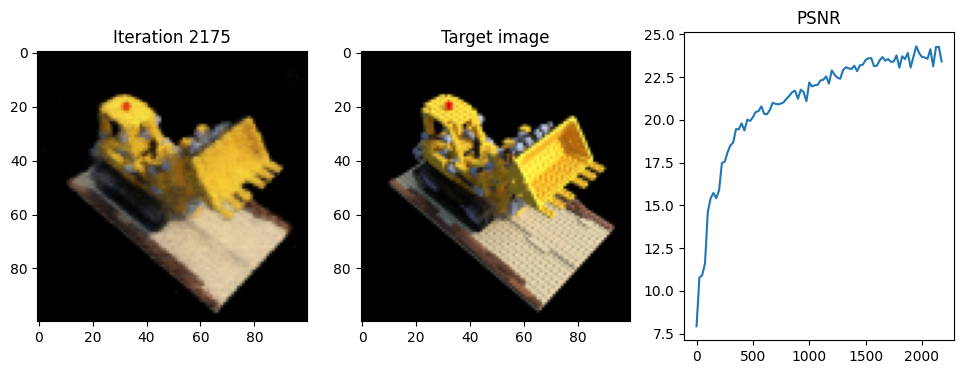

Iteration 2200  Loss: 0.0039  PSNR: 24.04  Time: 1.00 secs per iter,  37.53 mins in total


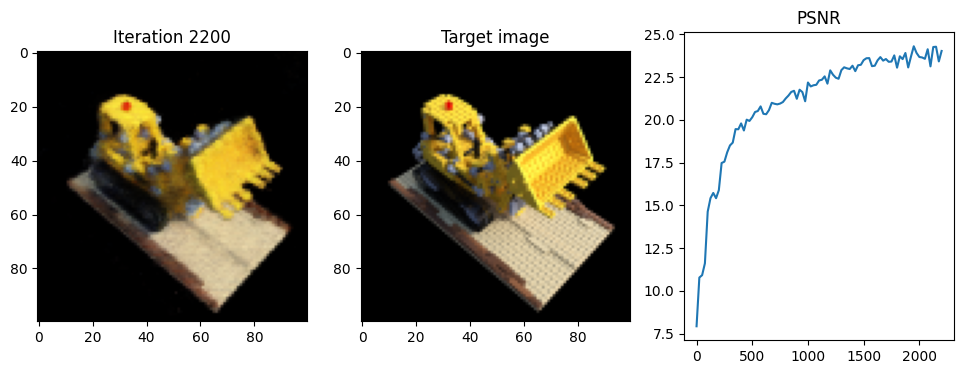

Iteration 2225  Loss: 0.0047  PSNR: 23.27  Time: 1.00 secs per iter,  37.95 mins in total


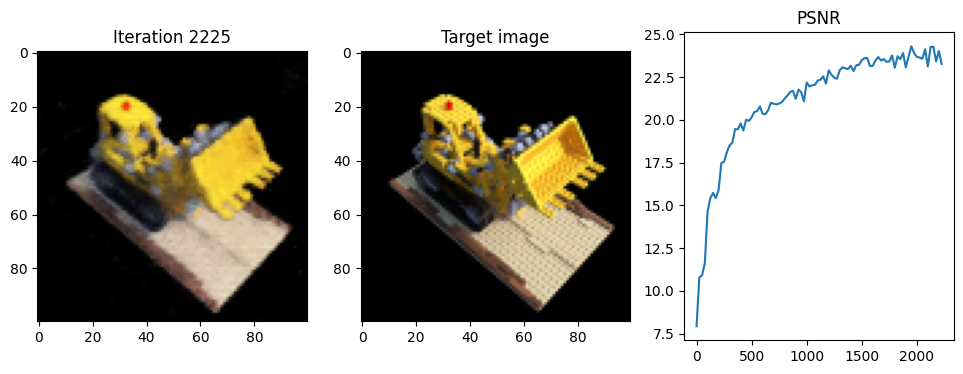

Iteration 2250  Loss: 0.0046  PSNR: 23.33  Time: 1.01 secs per iter,  38.37 mins in total


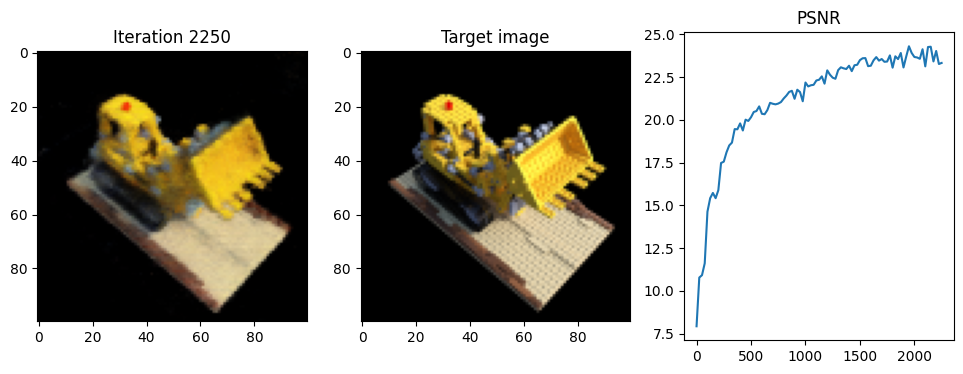

Iteration 2275  Loss: 0.0041  PSNR: 23.91  Time: 1.00 secs per iter,  38.79 mins in total


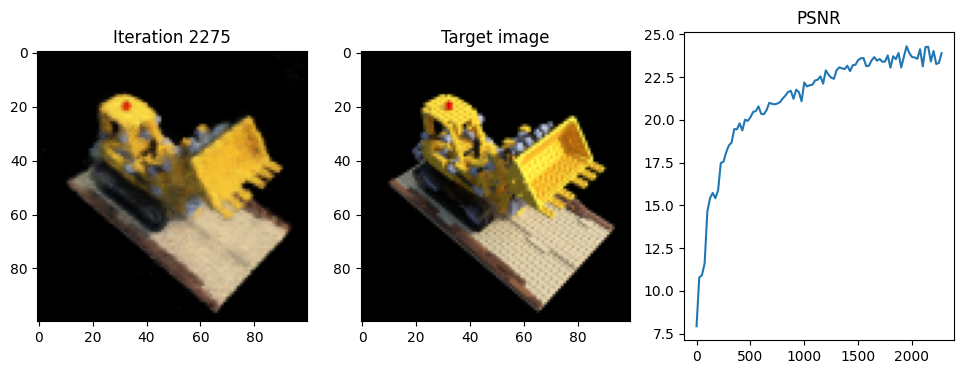

Iteration 2300  Loss: 0.0038  PSNR: 24.22  Time: 1.00 secs per iter,  39.21 mins in total


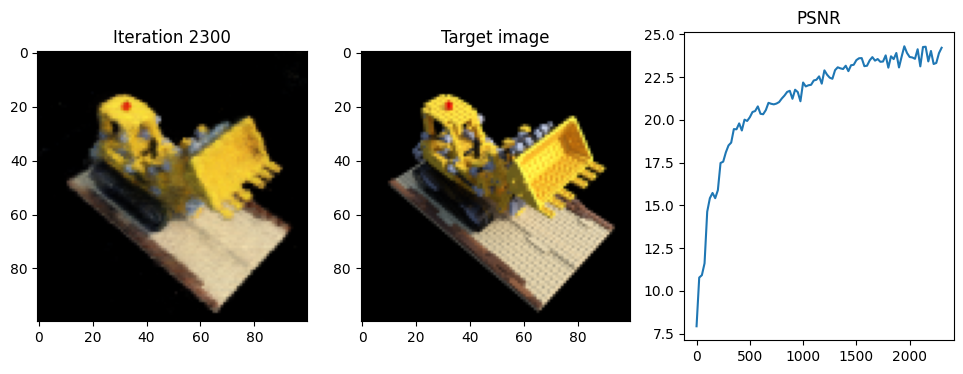

Iteration 2325  Loss: 0.0044  PSNR: 23.55  Time: 1.00 secs per iter,  39.62 mins in total


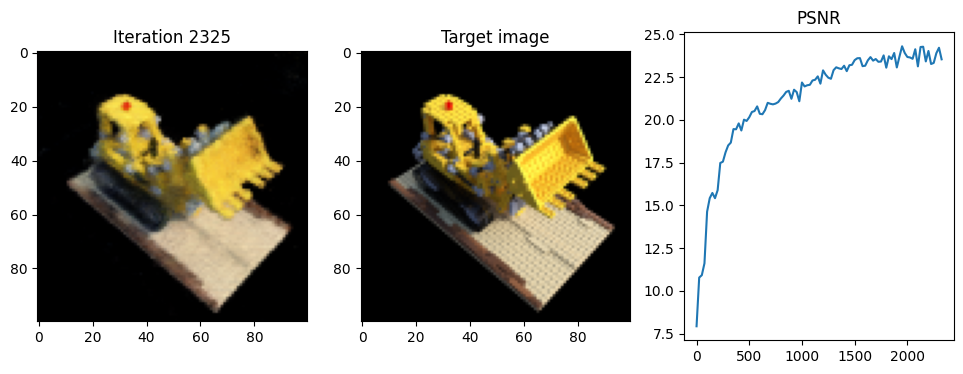

Iteration 2350  Loss: 0.0042  PSNR: 23.78  Time: 1.00 secs per iter,  40.04 mins in total


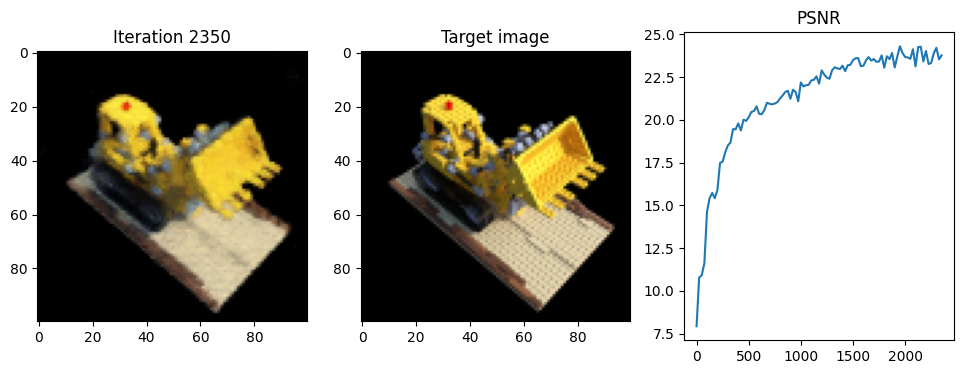

Iteration 2375  Loss: 0.0036  PSNR: 24.43  Time: 1.00 secs per iter,  40.46 mins in total


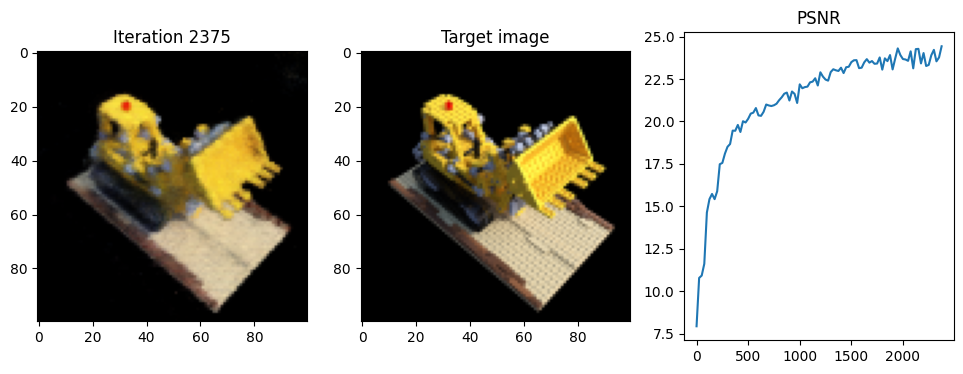

Iteration 2400  Loss: 0.0038  PSNR: 24.20  Time: 1.00 secs per iter,  40.87 mins in total


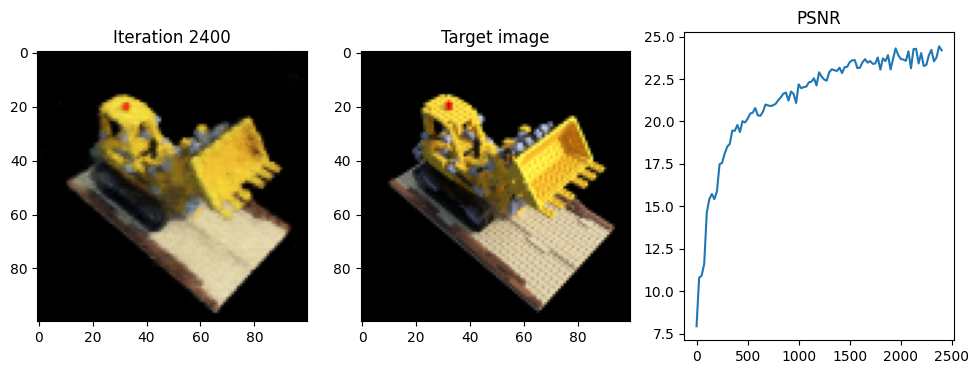

Iteration 2425  Loss: 0.0039  PSNR: 24.11  Time: 1.00 secs per iter,  41.29 mins in total


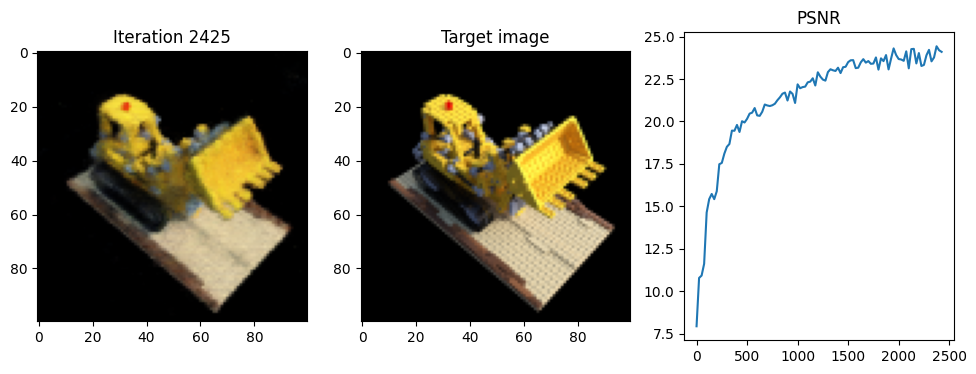

Iteration 2450  Loss: 0.0036  PSNR: 24.49  Time: 1.01 secs per iter,  41.71 mins in total


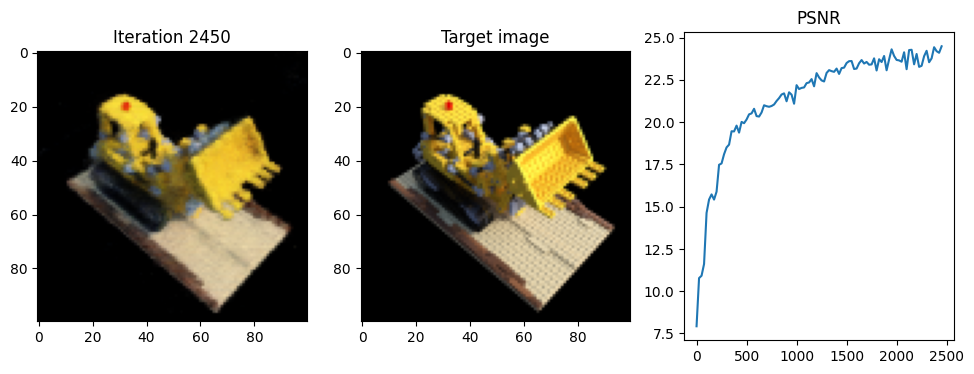

Iteration 2475  Loss: 0.0038  PSNR: 24.23  Time: 1.00 secs per iter,  42.13 mins in total


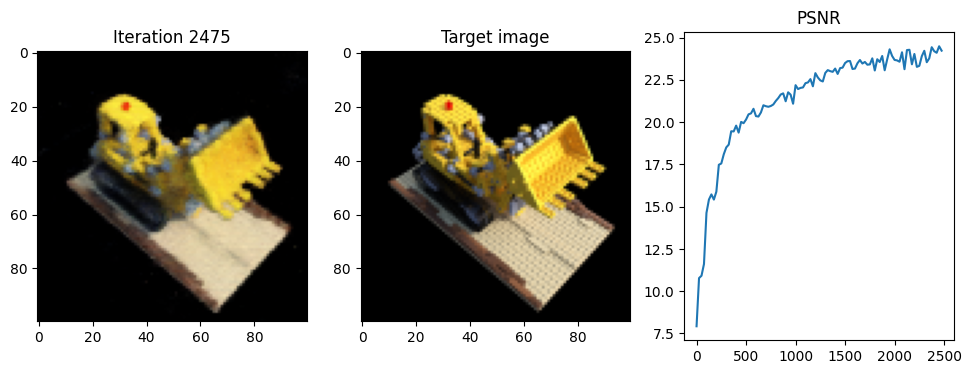

Iteration 2500  Loss: 0.0042  PSNR: 23.73  Time: 1.00 secs per iter,  42.55 mins in total


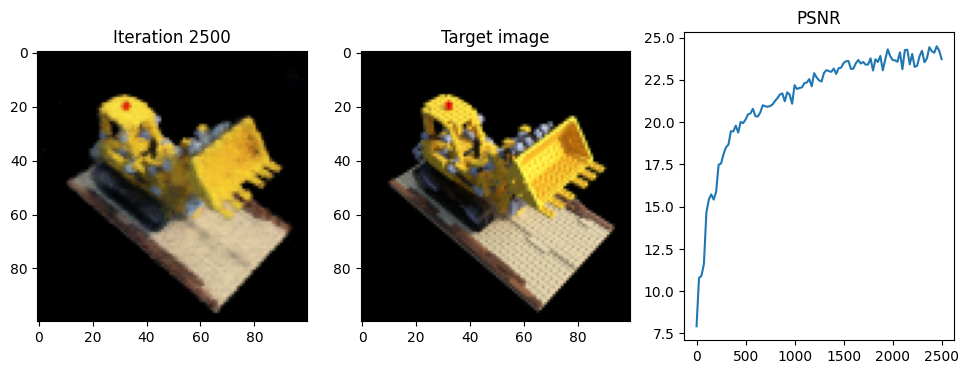

Iteration 2525  Loss: 0.0041  PSNR: 23.88  Time: 1.00 secs per iter,  42.97 mins in total


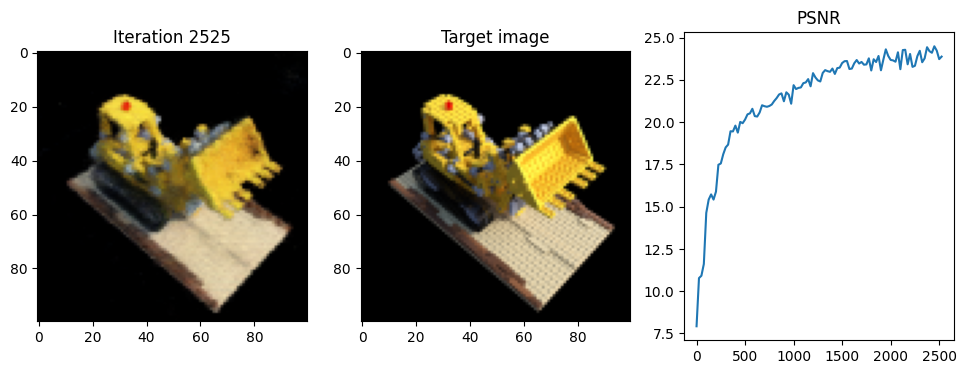

Iteration 2550  Loss: 0.0040  PSNR: 23.94  Time: 1.00 secs per iter,  43.38 mins in total


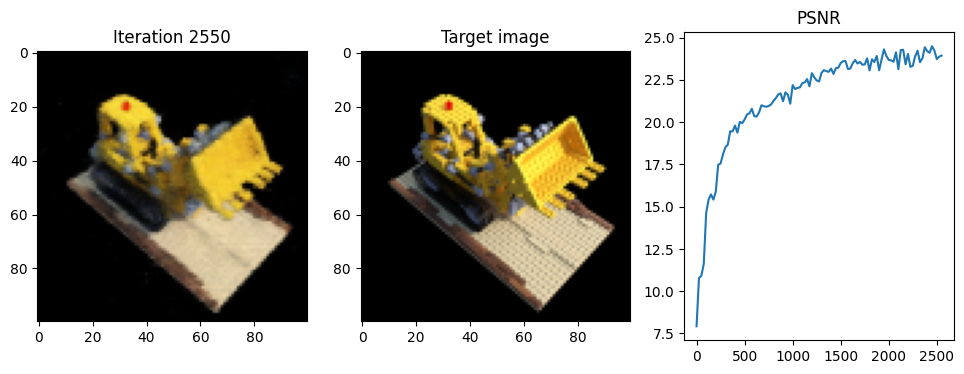

Iteration 2575  Loss: 0.0036  PSNR: 24.49  Time: 1.00 secs per iter,  43.80 mins in total


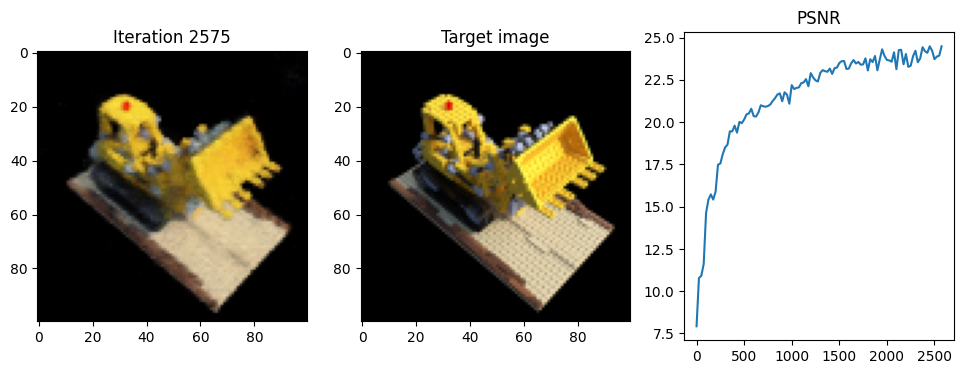

Iteration 2600  Loss: 0.0034  PSNR: 24.73  Time: 1.01 secs per iter,  44.22 mins in total


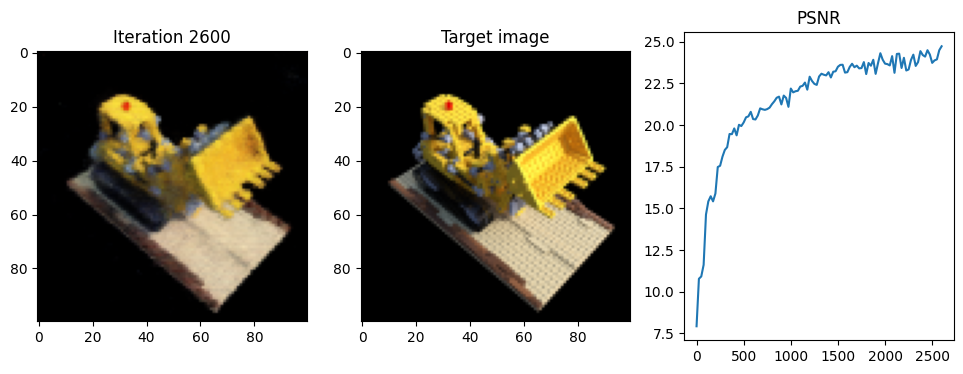

Iteration 2625  Loss: 0.0041  PSNR: 23.89  Time: 1.02 secs per iter,  44.64 mins in total


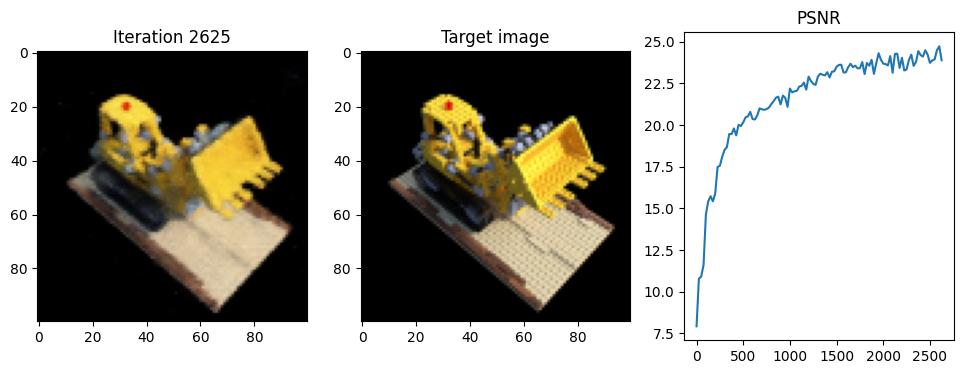

Iteration 2650  Loss: 0.0039  PSNR: 24.13  Time: 1.01 secs per iter,  45.06 mins in total


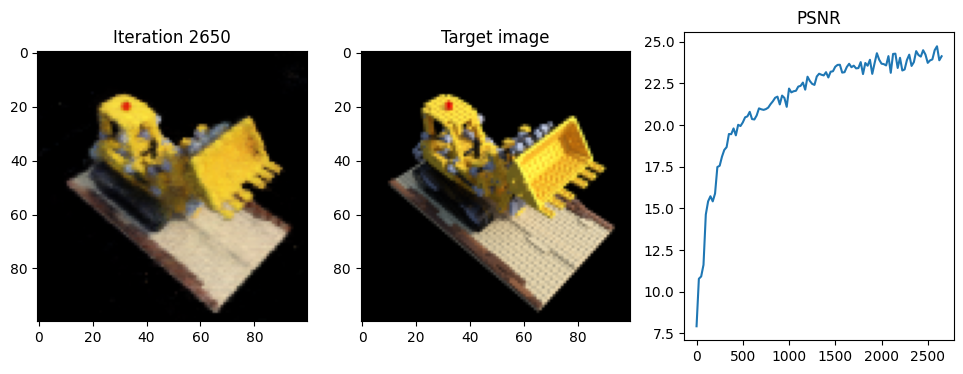

Iteration 2675  Loss: 0.0040  PSNR: 24.03  Time: 1.01 secs per iter,  45.48 mins in total


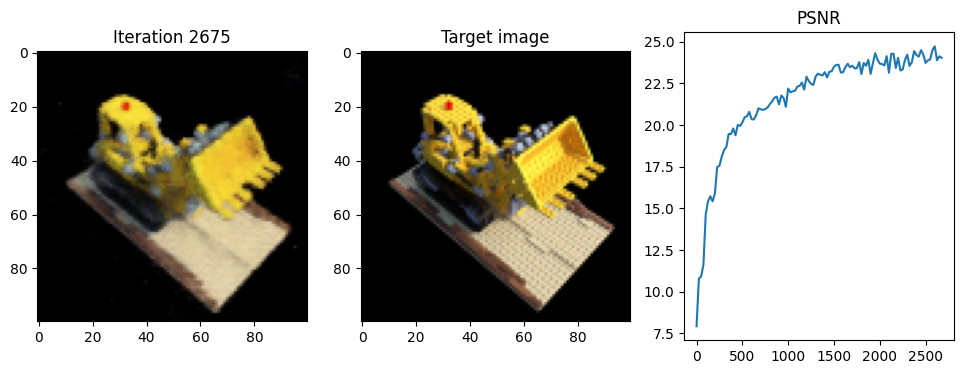

Iteration 2700  Loss: 0.0038  PSNR: 24.24  Time: 1.01 secs per iter,  45.91 mins in total


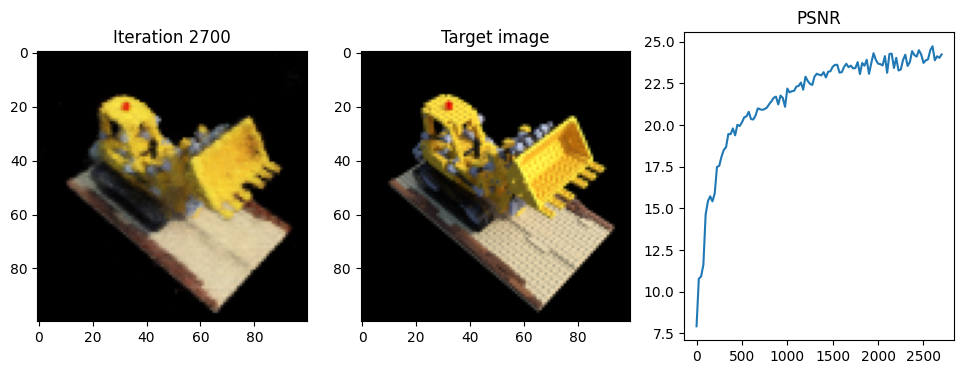

Iteration 2725  Loss: 0.0039  PSNR: 24.09  Time: 1.01 secs per iter,  46.33 mins in total


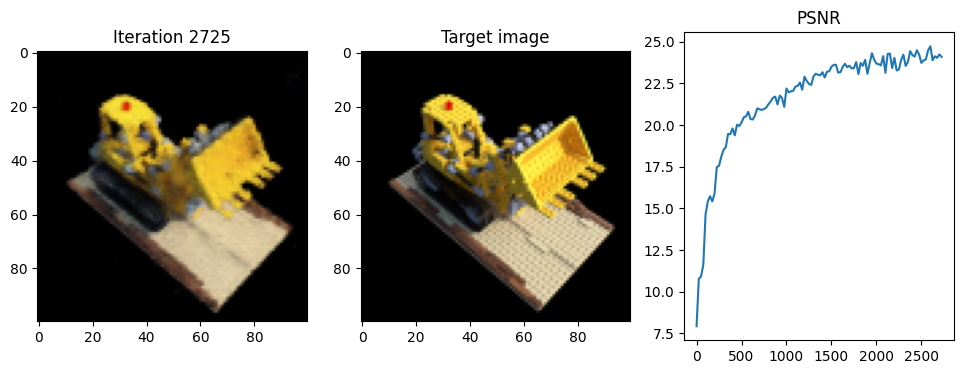

Iteration 2750  Loss: 0.0040  PSNR: 24.02  Time: 1.01 secs per iter,  46.75 mins in total


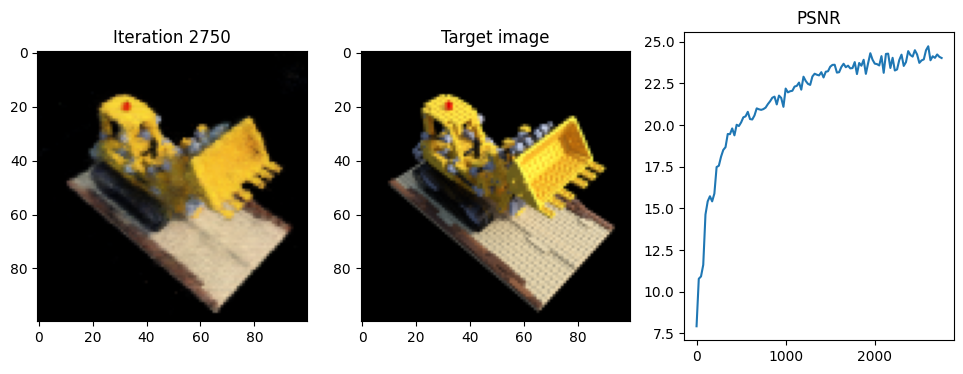

Iteration 2775  Loss: 0.0045  PSNR: 23.44  Time: 1.01 secs per iter,  47.17 mins in total


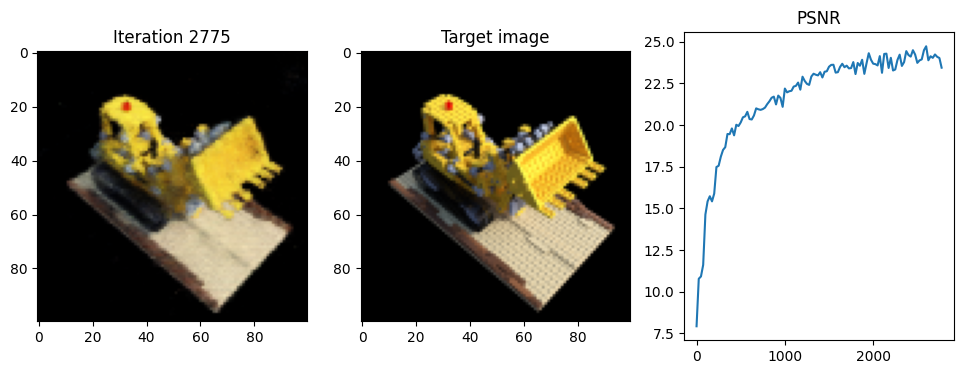

Iteration 2800  Loss: 0.0037  PSNR: 24.30  Time: 1.01 secs per iter,  47.59 mins in total


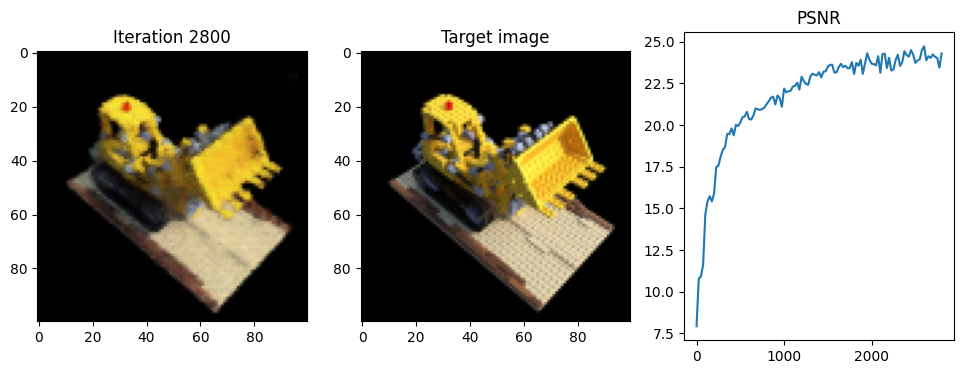

Iteration 2825  Loss: 0.0034  PSNR: 24.65  Time: 1.02 secs per iter,  48.01 mins in total


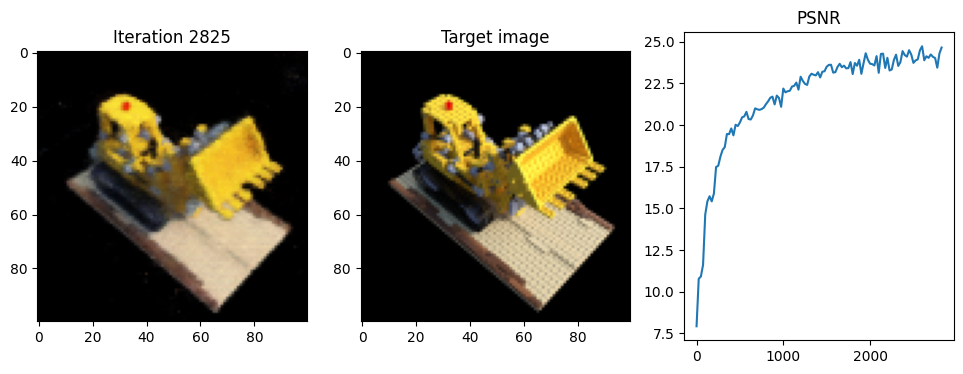

Iteration 2850  Loss: 0.0034  PSNR: 24.67  Time: 1.01 secs per iter,  48.44 mins in total


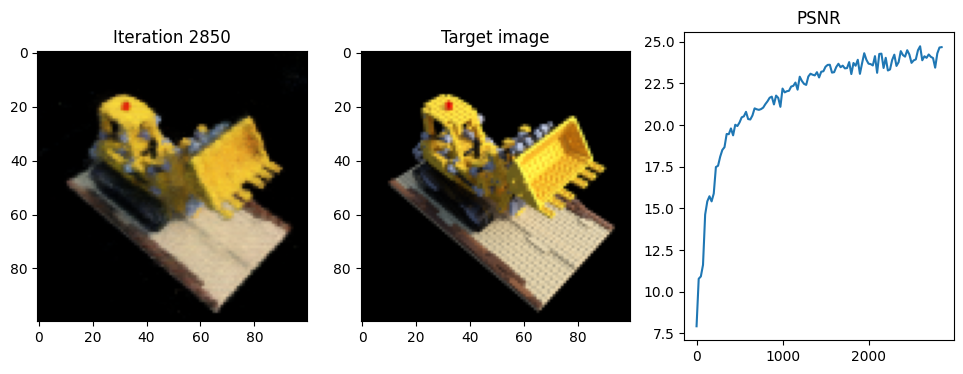

Iteration 2875  Loss: 0.0047  PSNR: 23.32  Time: 1.01 secs per iter,  48.86 mins in total


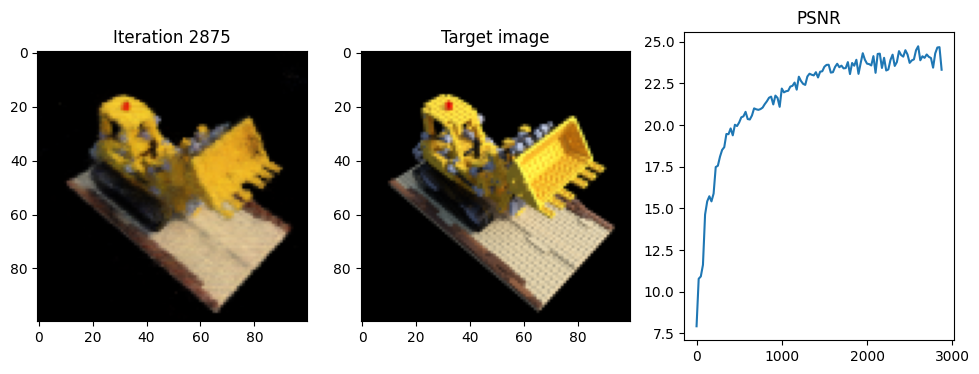

Iteration 2900  Loss: 0.0040  PSNR: 23.94  Time: 1.00 secs per iter,  49.27 mins in total


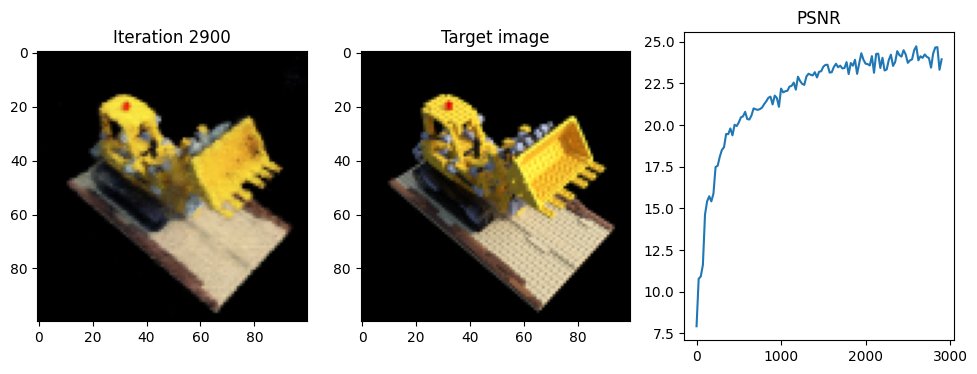

Iteration 2925  Loss: 0.0036  PSNR: 24.44  Time: 1.00 secs per iter,  49.69 mins in total


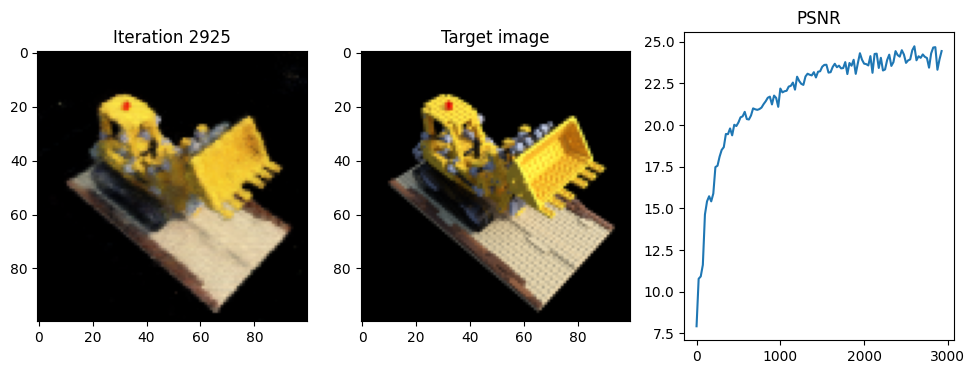

Iteration 2950  Loss: 0.0038  PSNR: 24.21  Time: 1.00 secs per iter,  50.11 mins in total


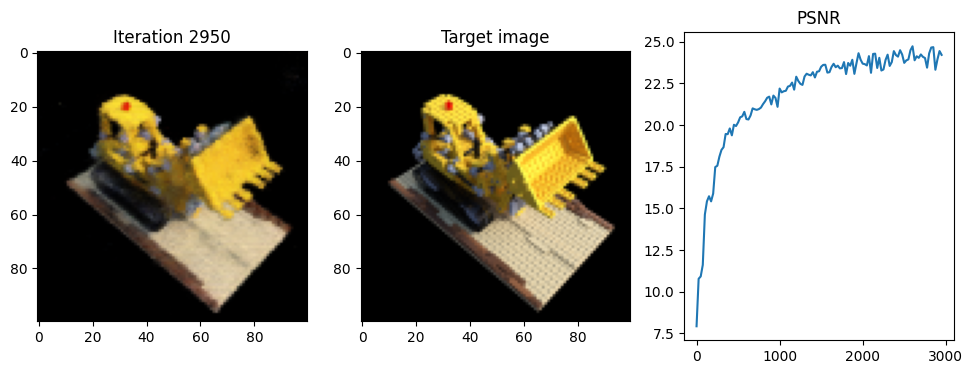

Iteration 2975  Loss: 0.0037  PSNR: 24.36  Time: 1.00 secs per iter,  50.53 mins in total


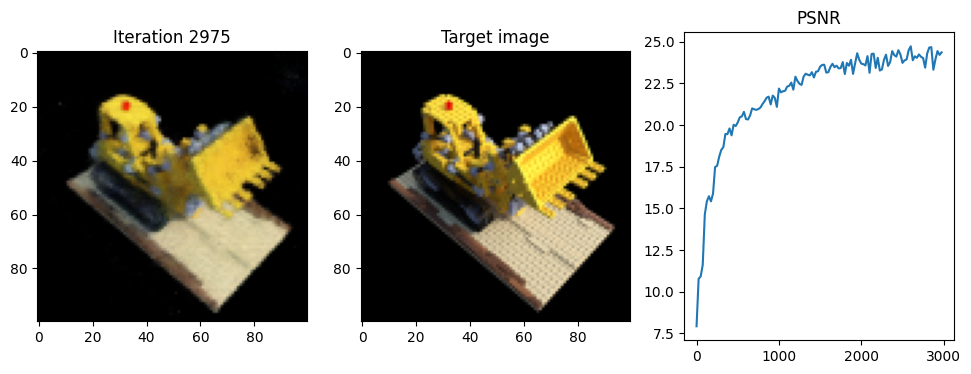

Iteration 3000  Loss: 0.0037  PSNR: 24.34  Time: 1.01 secs per iter,  50.95 mins in total


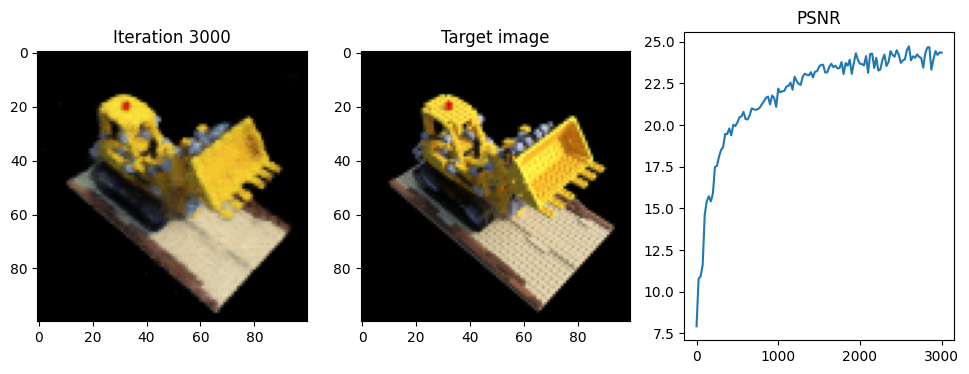

Done!


In [ ]:
for i in range(iterations+1):

    torch.cuda.empty_cache()
    optimizer.zero_grad()
    #choose randomly a picture for the forward pass
    rand = np.random.randint(len(images))
    image = images[rand]
    pose = poses[rand]

    # Run one iteration of NeRF and get the rendered RGB image.
    rec_image = one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)

    # Compute mean-squared error between the predicted and target images. Backprop!
    loss = criterion(rec_image, image)
    loss.backward()
    optimizer.step()


    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():
        # Render the held-out view
          test_rec_image = one_forward_pass(height, width, intrinsics, test_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)
        #calculate the loss and the psnr between the original test image and the reconstructed one.
          loss = criterion(test_rec_image, test_image)
          R = 1
          psnr = torch.tensor([10 * torch.log10(R**2 / loss)]).to(device)


        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))

        t = time.time()
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

print('Done!')